In [285]:
import json
from datetime import datetime

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pvlib
from scipy.stats import zscore
from sklearn.cluster import KMeans, FeatureAgglomeration
from sklearn.decomposition import PCA
from sklearn.ensemble import IsolationForest
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# disable warnings from pandas
pd.options.mode.chained_assignment = None  # default='warn'

In [286]:
portugal_df = pd.read_csv("data/PortugalPhotovoltaicDataset/dataset_feature_engineering.csv")

In [287]:
uk_df = pd.read_csv("data/UKOpenClimateFix/dataset_feature_engineering.csv")

In [288]:
portugal_metadata = pd.read_csv("data/PortugalPhotovoltaicDataset/pv_plants_metadata_aligned.csv")
uk_metadata = pd.read_csv("data/UKOpenClimateFix/uk_pv_metadata_aligned.csv")

In [289]:
portugal_df

,datetime,serial,name,produced energy,kwp,year,month,day,hour,minute,...,hour_cos,day_of_year_sin,day_of_year_cos,month_sin,month_cos,cell_temp,physical_model_prediction,relative_physical_model_prediction,relative_output,region
0,2019-01-01 02:00:00,84071567,Lisbon_1,0.0,46.00,2019,1,1,2,0,...,0.866,0.017,1.0,0.5,0.866,8.8,0.0,0.0,0.0,Portugal
1,2019-01-01 03:00:00,84071567,Lisbon_1,0.0,46.00,2019,1,1,3,0,...,0.707,0.017,1.0,0.5,0.866,8.5,0.0,0.0,0.0,Portugal
2,2019-01-01 04:00:00,84071567,Lisbon_1,0.0,46.00,2019,1,1,4,0,...,0.500,0.017,1.0,0.5,0.866,8.3,0.0,0.0,0.0,Portugal
3,2019-01-01 05:00:00,84071567,Lisbon_1,0.0,46.00,2019,1,1,5,0,...,0.259,0.017,1.0,0.5,0.866,8.0,0.0,0.0,0.0,Portugal
4,2019-01-01 06:00:00,84071567,Lisbon_1,0.0,46.00,2019,1,1,6,0,...,0.000,0.017,1.0,0.5,0.866,7.7,0.0,0.0,0.0,Portugal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
315544,2022-12-31 19:00:00,73061935,Loule,0.0,46.25,2022,12,31,19,0,...,0.259,0.000,1.0,-0.0,1.000,14.8,0.0,0.0,0.0,Portugal
315545,2022-12-31 20:00:00,73061935,Loule,0.0,46.25,2022,12,31,20,0,...,0.500,0.000,1.0,-0.0,1.000,14.7,0.0,0.0,0.0,Portugal
315546,2022-12-31 21:00:00,73061935,Loule,0.0,46.25,2022,12,31,21,0,...,0.707,0.000,1.0,-0.0,1.000,14.9,0.0,0.0,0.0,Portugal
315547,2022-12-31 22:00:00,73061935,Loule,0.0,46.25,2022,12,31,22,0,...,0.866,0.000,1.0,-0.0,1.000,14.9,0.0,0.0,0.0,Portugal


In [290]:
uk_df

,datetime,serial,produced energy,kwp,year,month,day,hour,minute,temperature_2m,...,day_of_year,day_of_year_sin,day_of_year_cos,month_sin,month_cos,cell_temp,physical_model_prediction,relative_physical_model_prediction,relative_output,region
0,2011-11-02 02:00:00,3062,0.0,4.0,2011,11,2,2,0,9.2,...,306,-0.85,0.527,-0.5,0.866,9.2,0.0,0.0,0.0,UK
1,2011-11-02 03:00:00,3062,0.0,4.0,2011,11,2,3,0,9.3,...,306,-0.85,0.527,-0.5,0.866,9.3,0.0,0.0,0.0,UK
2,2011-11-02 04:00:00,3062,0.0,4.0,2011,11,2,4,0,9.4,...,306,-0.85,0.527,-0.5,0.866,9.4,0.0,0.0,0.0,UK
3,2011-11-02 05:00:00,3062,0.0,4.0,2011,11,2,5,0,9.7,...,306,-0.85,0.527,-0.5,0.866,9.7,0.0,0.0,0.0,UK
4,2011-11-02 06:00:00,3062,0.0,4.0,2011,11,2,6,0,10.1,...,306,-0.85,0.527,-0.5,0.866,10.1,0.0,0.0,0.0,UK
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
803099,2021-09-30 19:00:00,26754,0.0,3.5,2021,9,30,19,0,12.1,...,273,-1.00,-0.013,-1.0,-0.000,12.1,0.0,0.0,0.0,UK
803100,2021-09-30 20:00:00,26754,0.0,3.5,2021,9,30,20,0,11.7,...,273,-1.00,-0.013,-1.0,-0.000,11.7,0.0,0.0,0.0,UK
803101,2021-09-30 21:00:00,26754,0.0,3.5,2021,9,30,21,0,11.5,...,273,-1.00,-0.013,-1.0,-0.000,11.5,0.0,0.0,0.0,UK
803102,2021-09-30 22:00:00,26754,0.0,3.5,2021,9,30,22,0,11.6,...,273,-1.00,-0.013,-1.0,-0.000,11.6,0.0,0.0,0.0,UK


# Plots

In [291]:
def plot_relative_frequency(df, kwp_col='kwp'):
    # Calculate relative frequency
    kwp_counts = df[kwp_col].value_counts(normalize=True)  # Normalize=True gives proportions
    kwp_percentages = kwp_counts * 100  # Convert to percentage

    # Plot the relative frequency
    plt.figure(figsize=(10, 6))
    kwp_percentages.sort_index().plot(kind='bar', color='cornflowerblue', alpha=0.8)
    plt.title('Relative Frequency of KWP Values')
    plt.xlabel('KWP (kW Peak)')
    plt.ylabel('Proportion (%)')
    plt.xticks(rotation=45)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()

    # Print for reference
    print("Relative Frequency of KWP Values (%):")
    print(kwp_percentages)

In [292]:
def plot_scatter(data, column_1, column_2, x_label, y_label, title):
    plt.figure(figsize=(10, 6))
    plt.scatter(data[column_1], data[column_2], alpha=0.6, color='blue', edgecolors='k')
    plt.title(title, fontsize=16)
    plt.xlabel(x_label, fontsize=12)
    plt.ylabel(y_label, fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.show()


In [293]:
def time_n_features_line_plot(data, datetime_column, features, x_label, y_label, title):
    data[datetime_column] = pd.to_datetime(data[datetime_column])

    plt.figure(figsize=(10, 6))
    for feature in features:
        plt.plot(data[datetime_column], data[feature], label=feature, alpha=0.7)
    plt.legend()
    plt.xlabel(x_label, fontsize=12)
    plt.ylabel(y_label, fontsize=12)
    plt.title(title, fontsize=16)
    plt.show()

In [294]:
def correlation_heatmap(data, title, features=None):
    if features is None:
        features = data.columns

    data = data[features].copy()

    # Generate correlation matrix
    corr = data.corr()


    # Set up the matplotlib figure
    plt.figure(figsize=(11, 9))

    # Draw the heatmap without annotations (i.e., remove numbers)
    sns.heatmap(corr, cmap='coolwarm', fmt=".2f", vmin=-1, vmax=1, center=0, square=True, linewidths=.5, cbar_kws={"shrink": 0.8}, annot=False)

    plt.title(title, fontsize=16)
    plt.show()

In [295]:
def heatmap(x, y, **kwargs):
    # https://github.com/drazenz/heatmaps/blob/master/heatmap/heatmap.py
    if 'color' in kwargs:
        color = kwargs['color']
    else:
        color = [1]*len(x)

    if 'palette' in kwargs:
        palette = kwargs['palette']
        n_colors = len(palette)
    else:
        n_colors = 256 # Use 256 colors for the diverging color palette
        palette = sns.color_palette("Blues", n_colors)

    if 'color_range' in kwargs:
        color_min, color_max = kwargs['color_range']
    else:
        color_min, color_max = min(color), max(color) # Range of values that will be mapped to the palette, i.e. min and max possible correlation

    def value_to_color(val):
        if color_min == color_max:
            return palette[-1]
        else:
            val_position = float((val - color_min)) / (color_max - color_min) # position of value in the input range, relative to the length of the input range
            val_position = min(max(val_position, 0), 1) # bound the position betwen 0 and 1
            ind = int(val_position * (n_colors - 1)) # target index in the color palette
            return palette[ind]

    if 'size' in kwargs:
        size = kwargs['size']
    else:
        size = [1]*len(x)

    if 'size_range' in kwargs:
        size_min, size_max = kwargs['size_range'][0], kwargs['size_range'][1]
    else:
        size_min, size_max = min(size), max(size)

    size_scale = kwargs.get('size_scale', 500)

    def value_to_size(val):
        if size_min == size_max:
            return 1 * size_scale
        else:
            val_position = (val - size_min) * 0.99 / (size_max - size_min) + 0.01 # position of value in the input range, relative to the length of the input range
            val_position = min(max(val_position, 0), 1) # bound the position betwen 0 and 1
            return val_position * size_scale
    if 'x_order' in kwargs:
        x_names = [t for t in kwargs['x_order']]
    else:
        x_names = [t for t in sorted(set([v for v in x]))]
    x_to_num = {p[1]:p[0] for p in enumerate(x_names)}

    if 'y_order' in kwargs:
        y_names = [t for t in kwargs['y_order']]
    else:
        y_names = [t for t in sorted(set([v for v in y]))]
    y_to_num = {p[1]:p[0] for p in enumerate(y_names)}

    plot_grid = plt.GridSpec(1, 15, hspace=0.2, wspace=0.1) # Setup a 1x10 grid
    ax = plt.subplot(plot_grid[:,:-1]) # Use the left 14/15ths of the grid for the main plot

    marker = kwargs.get('marker', 's')

    kwargs_pass_on = {k:v for k,v in kwargs.items() if k not in [
         'color', 'palette', 'color_range', 'size', 'size_range', 'size_scale', 'marker', 'x_order', 'y_order', 'xlabel', 'ylabel'
    ]}

    ax.scatter(
        x=[x_to_num[v] for v in x],
        y=[y_to_num[v] for v in y],
        marker=marker,
        s=[value_to_size(v) for v in size],
        c=[value_to_color(v) for v in color],
        **kwargs_pass_on
    )
    ax.set_xticks([v for k,v in x_to_num.items()])
    ax.set_xticklabels([k for k in x_to_num], rotation=90, horizontalalignment='right')
    ax.set_yticks([v for k,v in y_to_num.items()])
    ax.set_yticklabels([k for k in y_to_num])

    ax.grid(False, 'major')
    ax.grid(True, 'minor')
    ax.set_xticks([t + 0.5 for t in ax.get_xticks()], minor=True)
    ax.set_yticks([t + 0.5 for t in ax.get_yticks()], minor=True)

    ax.set_xlim([-0.5, max([v for v in x_to_num.values()]) + 0.5])
    ax.set_ylim([-0.5, max([v for v in y_to_num.values()]) + 0.5])
    ax.set_facecolor('#F1F1F1')

    ax.set_xlabel(kwargs.get('xlabel', ''))
    ax.set_ylabel(kwargs.get('ylabel', ''))

    # Add color legend on the right side of the plot
    if color_min < color_max:
        ax = plt.subplot(plot_grid[:,-1]) # Use the rightmost column of the plot

        col_x = [0]*len(palette) # Fixed x coordinate for the bars
        bar_y=np.linspace(color_min, color_max, n_colors) # y coordinates for each of the n_colors bars

        bar_height = bar_y[1] - bar_y[0]
        ax.barh(
            y=bar_y,
            width=[5]*len(palette), # Make bars 5 units wide
            left=col_x, # Make bars start at 0
            height=bar_height,
            color=palette,
            linewidth=0
        )
        ax.set_xlim(1, 2) # Bars are going from 0 to 5, so lets crop the plot somewhere in the middle
        ax.grid(False) # Hide grid
        ax.set_facecolor('white') # Make background white
        ax.set_xticks([]) # Remove horizontal ticks
        ax.set_yticks(np.linspace(min(bar_y), max(bar_y), 3)) # Show vertical ticks for min, middle and max
        ax.yaxis.tick_right() # Show vertical ticks on the right

def corrplot(data, size_scale=500, marker='s'):
    plt.figure(figsize=(11, 9))  # Set the figure size
    corr = pd.melt(data.reset_index(), id_vars='index').replace(np.nan, 0)
    corr.columns = ['x', 'y', 'value']
    heatmap(
        corr['x'], corr['y'],
        color=corr['value'], color_range=[-1, 1],
        palette=sns.diverging_palette(20, 220, n=256),
        size=corr['value'].abs(), size_range=[0,1],
        marker=marker,
        x_order=data.columns,
        y_order=data.columns[::-1],
        size_scale=size_scale
    )

In [296]:
def plot_column_distribution(data, column, title=None, xlabel=None, ylabel="Frequency", color='blue', bins=50):
    """
    Plots the distribution of a specified numerical column.

    Parameters:
    data (pd.DataFrame): The input dataset containing the column to plot.
    column (str): The column name for the distribution plot.
    title (str): The title of the plot (default: "Distribution of {column}").
    xlabel (str): The label for the x-axis (default: column name).
    ylabel (str): The label for the y-axis (default: "Frequency").
    color (str): The color of the distribution plot.
    bins (int): The number of bins for the histogram (default: 50).
    """
    # Set default values if not provided
    if title is None:
        title = f"Distribution of {column}"
    if xlabel is None:
        xlabel = column

    # Plot histogram
    plt.figure(figsize=(10, 6))
    plt.hist(data[column], bins=bins, alpha=0.7, color=color, edgecolor='black')
    plt.title(title, fontsize=16)
    plt.xlabel(xlabel, fontsize=14)
    plt.ylabel(ylabel, fontsize=14)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()

In [297]:
def plot_actual_vs_predicted(y_true, y_pred, title='Actual vs. Predicted', xlabel='Actual Values', ylabel='Predicted Values'):
    """
    Plots a scatter plot of actual vs predicted values with a trend line.

    Parameters:
    y_true (array-like): The actual values.
    y_pred (array-like): The predicted values.
    title (str): Title of the plot.
    xlabel (str): Label for the x-axis.
    ylabel (str): Label for the y-axis.
    """
    plt.figure(figsize=(10, 6))

    # Scatter plot: Actual vs Predicted
    plt.scatter(y_true, y_pred, color='blue', alpha=0.6, label='Predictions', edgecolor='k')

    # Perfect fit line
    max_val = max(max(y_true), max(y_pred))
    min_val = min(min(y_true), min(y_pred))
    plt.plot([min_val, max_val], [min_val, max_val], color='red', linestyle='--', label='Perfect Fit Line (y=x)')

    # Linear trend line (Least-squares fit)
    model = LinearRegression()
    y_true_reshaped = np.array(y_true).reshape(-1, 1)  # Reshape for LinearRegression
    model.fit(y_true_reshaped, y_pred)
    trend_line = model.predict(y_true_reshaped)

    # Plot trend line
    plt.plot(y_true, trend_line, color='green', linestyle='-.', label='Trend Line (Fit)')

    # Add labels, title, and legend
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.show()

In [298]:
def plot_data_skew(df, features, plot_type="histogram"):
    """
    Plot data skew for specified features.

    Parameters:
        df (pd.DataFrame): Input dataset.
        features (list): List of features/columns to plot.
        plot_type (str): Type of plot to use ('histogram', 'density', or 'boxplot').

    Returns:
        None
    """
    
    for i, feature in enumerate(features, 1):
        plt.figure(figsize=(12, 8))
        
        if plot_type == "histogram":
            sns.histplot(df[feature], kde=True, bins=30, color="blue", alpha=0.6)
            plt.title(f"Histogram with KDE: {feature}")
        elif plot_type == "density":
            sns.kdeplot(df[feature], color="green", fill=True, alpha=0.5)
            plt.title(f"Density Plot: {feature}")
        elif plot_type == "boxplot":
            sns.boxplot(x=df[feature], color="orange")
            plt.title(f"Boxplot: {feature}")
        else:
            raise ValueError("Invalid plot_type. Use 'histogram', 'density', or 'boxplot'.")

        plt.xlabel(feature)
        plt.tight_layout()

    plt.show()

# New features

In [299]:
def add_moving_average(data, column, datetime_col, window_size, metadata):
    """
    Add a moving average column to the dataframe.
    """
    data[datetime_col] = pd.to_datetime(data[datetime_col])
    new_data = []

    for _, row in metadata.iterrows():
        serial = row['serial']

        selected_data = data[data["serial"] == serial].copy()

        if selected_data is None:
            continue

        column_name = f"{column}_{window_size}_moving_average"
        selected_data[column_name] = selected_data.rolling(
            f'{window_size}h',
            on=datetime_col,
            closed='right'
        )[column].mean()

        # drop NaN values after calculating the moving average
        selected_data.dropna(inplace=True)

        new_data.append(selected_data)

    return pd.concat(new_data)

In [300]:
def add_clear_sky_index(data, metadata):

    updated_data = []

    for _, row in metadata.iterrows():
        latitude = row['latitude']
        longitude = row['longitude']

        selected_data = data[data["serial"] == row["serial"]].copy()

        if selected_data is None:
            continue

        location = pvlib.location.Location(latitude=latitude, longitude=longitude)

        times = pd.date_range(start=selected_data['datetime'].min(), end=selected_data['datetime'].max(), freq='1h')

        cs = location.get_clearsky(times, model='ineichen')
        cs = cs.set_index(times)  # Set times as index to match selected_data
        cs = cs.reindex(selected_data.set_index('datetime').index)  # Reindex to ensure alignment

        selected_data = selected_data.set_index('datetime')
        selected_data['clearsky_index'] = pvlib.irradiance.clearsky_index(selected_data["shortwave_radiation"], cs['ghi'])

        selected_data = selected_data.reset_index()

        updated_data.append(selected_data)

    return pd.concat(updated_data)

In [301]:
def calculate_cell_temperature(Ta, G):
    """
    Calculate the cell temperature of a PV module.

    Parameters:
    - Ta (float or array-like): Ambient temperature (°C).
    - G (float or array-like): Solar irradiance (W/m²).

    Returns:
    - Tc (float or array-like): Cell temperature (°C).
    """

    NOCT = 45  # Nominal Operating Cell Temperature (°C)
    Tc = Ta + (NOCT - 20) * (G/1000)
    return Tc

In [302]:
def calculate_cyclic_encoding(df, column, period, decimals=None):
    """
    Adds cyclic encoding for a specified column with optional rounding.

    Parameters:
    df (pd.DataFrame): The input DataFrame.
    column (str): The column to apply cyclic encoding to.
    period (int): The period for cyclic encoding (e.g., 24 for hours, 365 for days of year).
    decimals (int or None): The number of decimal places to round to. If None, no rounding.

    Returns:
    pd.DataFrame: The DataFrame with added sine and cosine columns.
    """
    df[f'{column}_sin'] = np.sin(2 * np.pi * df[column] / period)
    df[f'{column}_cos'] = np.cos(2 * np.pi * df[column] / period)

    if decimals is not None:
        df[f'{column}_sin'] = df[f'{column}_sin'].round(decimals)
        df[f'{column}_cos'] = df[f'{column}_cos'].round(decimals)

    return df

In [303]:
def apply_pca(df, numerical_columns, n_components=2):
    pca = PCA(n_components=n_components)
    pca_data = pca.fit_transform(df[numerical_columns])

    # Create DataFrame with PCA components
    pca_df = pd.DataFrame(data=pca_data, columns=[f'PC{i+1}' for i in range(n_components)])

    # Concatenate PCA components with the original DataFrame

    return pca_df, pca

In [304]:
def calculate_joules_hourly(data, irradiance_col):
    """
    Calculates the energy in Joules for each hourly measurement in the dataset.

    Parameters:
    data (pd.DataFrame): The input dataset containing irradiance values.
    irradiance_col (str): The column name containing the irradiance values in W/m².

    Returns:
    pd.DataFrame: The input DataFrame with an additional column 'joules' representing the calculated energy.
    """
    # 1 hour = 3600 seconds
    seconds_in_hour = 3600

    # Calculate Joules for each row: W/m² * 3600 seconds
    data['joules'] = data[irradiance_col] * seconds_in_hour

    print(f"Added 'joules' column to DataFrame, representing energy in Joules.")
    return data

In [305]:
def categories_cloud_cover(data):
    """
    Categorizes cloud cover into bins: 'low', 'medium', 'high', 'very high'.

    Parameters:
    - data (pd.DataFrame): The input DataFrame containing 'cloud_cover' column.

    Returns:
    - pd.DataFrame: The DataFrame with a new column 'cloud_cover_category'.
    """
    data['cloud_cover_category'] = pd.cut(
        data['cloud_cover'],
        bins=[0, 25, 50, 75, 100],
        labels=['low', 'medium', 'high', 'very high'],
        include_lowest=True  # Ensures 0 is included in the 'low' bin
    )
    return data

In [306]:
def kmeans_cluster_csi_cloud_cover(
    data: pd.DataFrame,
    csi_col: str = 'clearsky_index',
    cloud_cover_col: str = 'cloud_cover',
    n_clusters: int = 3,
    random_state: int = 42
) -> (pd.DataFrame, pd.DataFrame):

    # ---------------------------------------------------------------------
    # 1. Validate input DataFrame and columns
    # ---------------------------------------------------------------------
    if not isinstance(data, pd.DataFrame):
        raise TypeError("Input 'data' must be a pandas DataFrame.")

    if csi_col not in data.columns or cloud_cover_col not in data.columns:
        raise ValueError(
            f"Columns '{csi_col}' and/or '{cloud_cover_col}' not found in the dataset."
        )

    # ---------------------------------------------------------------------
    # 2. Reset index of the original DataFrame to preserve row mapping
    # ---------------------------------------------------------------------
    df_reset = data.reset_index(drop=False).rename(columns={'index': 'orig_index'})

    # ---------------------------------------------------------------------
    # 3. Create a cleaned subset for clustering (drop NaNs in csi_col/cloud_cover_col)
    # ---------------------------------------------------------------------
    df_cleaned = df_reset[['orig_index', csi_col, cloud_cover_col]].dropna(
        subset=[csi_col, cloud_cover_col]
    )
    if df_cleaned.empty:
        raise ValueError("No valid rows remain after removing NaNs in the specified columns.")

    # Ensure columns are numeric
    if not pd.api.types.is_numeric_dtype(df_cleaned[csi_col]) or \
       not pd.api.types.is_numeric_dtype(df_cleaned[cloud_cover_col]):
        raise ValueError(
            f"Columns '{csi_col}' and '{cloud_cover_col}' must be numeric."
        )

    # ---------------------------------------------------------------------
    # 4. Fit KMeans on the cleaned subset
    # ---------------------------------------------------------------------
    kmeans = KMeans(n_clusters=n_clusters, random_state=random_state)
    kmeans.fit(df_cleaned[[csi_col, cloud_cover_col]])

    df_cleaned['kmeans_cluster'] = kmeans.labels_

    # ---------------------------------------------------------------------
    # 5. Merge the cluster labels back using 'orig_index'
    # ---------------------------------------------------------------------
    merged = pd.merge(
        df_reset,
        df_cleaned[['orig_index', 'kmeans_cluster']],
        on='orig_index',
        how='left'
    )

    # Rename 'kmeans_cluster' to 'cluster'
    merged.rename(columns={'kmeans_cluster': 'cluster'}, inplace=True)

    # Fill NaN cluster labels with -1 (for rows that didn't exist in df_cleaned)
    merged['cluster'] = merged['cluster'].fillna(-1).astype(int)

    # ---------------------------------------------------------------------
    # 6. Drop unnecessary columns and restore original index
    # ---------------------------------------------------------------------

    merged.set_index('orig_index', drop=True, inplace=True)


    # ---------------------------------------------------------------------
    # 7. Build a DataFrame of cluster centers
    # ---------------------------------------------------------------------
    cluster_centers = pd.DataFrame(
        kmeans.cluster_centers_,
        columns=[csi_col, cloud_cover_col]
    )

    # ---------------------------------------------------------------------
    # 8. (Optional) Print debug info
    # ---------------------------------------------------------------------
    print(f"Original dataset size: {data.shape[0]}")
    print(f"Cleaned dataset size (for clustering): {df_cleaned.shape[0]}")
    print(f"Number of cluster labels: {len(kmeans.labels_)}")
    print("First few rows of cleaned DataFrame with clusters:")
    print(df_cleaned.head(), "\n")

    print("Cluster Centers:")
    print(cluster_centers, "\n")

    # ---------------------------------------------------------------------
    # 9. Return the final DataFrame + cluster centers
    # ---------------------------------------------------------------------
    final_df = merged
    return final_df, cluster_centers

# Data Cleaning

In [307]:
def remove_clear_sky_index_outliers(data, threshold):
    """
    Remove outliers from the clear sky index.

    Clear sky is 1.0 it means fully clear sky (reaches math maximum). It's considered to be maximum, solar irradiance can be higher due to albedo effect. While this effect isn't rare but enhanced clear sky index is considered to be an outlier.

    """
    return data[data["clearsky_index"] <= threshold]

In [308]:
def remove_outliers_isolation_forest(
        data,
        features=None,
        contamination=0.05,
        reason="outliers"
):
    if features is None:
        features = ['normalized_energy', 'poa', 'apparent_temperature', 'relative_humidity_2m']

    iso_forest = IsolationForest(contamination=contamination, random_state=42)
    data['is_outlier'] = iso_forest.fit_predict(data[features])

    # Step 2: Filter outliers (keep only inliers)
    df_clean = data[data['is_outlier'] == 1].copy()
    outliers = data[data['is_outlier'] == -1].copy()
    outliers['reason'] = reason

    print(f"Original dataset size: {data.shape}")
    print(f"Cleaned {len(outliers )} due to {reason}")
    print(f"Cleaned dataset size: {df_clean.shape}")

    df_clean.drop(columns=['is_outlier'], inplace=True)

    return df_clean, outliers

In [309]:
def remove_outliers_z_score(
        data,
        features=None
):

    # Calculate Z-scores
    if features is None:
        features = ['produced energy', 'poa', 'apparent_temperature', 'relative_humidity_2m']

    for feature in features:
        data[f'{feature}_Z'] = zscore(data[feature])

    # Define threshold
    threshold = 3

    # Identify outliers for each feature
    for feature in features:
        data[f'{feature}_Outlier'] = data[f'{feature}_Z'].abs() > threshold

        df_clean = data[data[f'{feature}_Outlier'] == False].copy()

    print(f"Original dataset size: {data.shape}")
    print(f"Cleaned by zscore dataset size: {df_clean.shape}")

    return df_clean

In [310]:
def remove_outliers_percentile(data, col_name, lower_percentile=2.5, upper_percentile=97.5):
    """
    Filters the dataset to retain a specified percentage of the values based on the chosen column.
    Also returns the outliers DataFrame.

    Parameters:
    data (pd.DataFrame): The input dataset.
    col_name (str): The column name to filter by.
    lower_percentile (float): The lower percentile for filtering (default is 2.5).
    upper_percentile (float): The upper percentile for filtering (default is 97.5).

    Returns:
    pd.DataFrame: A filtered DataFrame containing values within the specified percentiles.
    pd.DataFrame: A DataFrame containing the outliers.
    """
    # Calculate the bounds based on the specified percentiles
    lower_bound = np.percentile(data[col_name], lower_percentile)
    upper_bound = np.percentile(data[col_name], upper_percentile)

    print(f"Lower bound for {col_name}: {lower_bound}, Upper bound for {col_name}: {upper_bound}")

    # Filter data to keep only values within the bounds
    filtered_data = data[(data[col_name] >= lower_bound) & (data[col_name] <= upper_bound)]

    # Identify outliers outside the bounds
    outliers_data = data[(data[col_name] < lower_bound) | (data[col_name] > upper_bound)]

    print(f"Original data size: {len(data)}, Filtered data size: {len(filtered_data)}, Outliers size: {len(outliers_data)}")

    return filtered_data, outliers_data

In [311]:
def remove_outliers_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    filtered_df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
    print(f"Removed {len(df) - len(filtered_df)} outliers")
    return filtered_df, outliers

In [312]:
def filter_logical_inconsistencies(data: pd.DataFrame):
    """
    Filters and/or modifies rows in 'data' that violate logical or physical constraints
    for PV generation and associated weather conditions.

    Returns:
      - cleaned_data: the filtered/cleaned dataset
      - suspicious_data: rows that were removed or flagged as suspicious (with reason)
    """

    # A separate DataFrame to store all suspicious rows
    suspicious_data = pd.DataFrame(columns=data.columns.to_list() + ["reason"])

    def remove_suspicious_rows(df: pd.DataFrame, condition, reason: str):
        """
        Helper: removes rows failing 'condition' from df,
        and collects them as suspicious with an added 'reason' column.
        """
        before = df.shape[0]

        # Rows that do NOT satisfy the condition are suspicious
        suspicious = df.loc[~condition].copy()
        suspicious["reason"] = reason

        # Keep only rows that meet the condition
        df = df.loc[condition].copy()

        removed_count = before - df.shape[0]
        if removed_count > 0:
            print(f"Removed {removed_count} rows due to {reason}")

        return df, suspicious

    def modify_rows(df: pd.DataFrame, mask, col_to_modify: str, new_value, reason: str):
        """
        Helper: modifies certain rows (those matching 'mask'),
        sets a column to 'new_value',
        and records them in suspicious_data (though these are "modified," not removed).
        """
        to_modify = df.loc[mask].copy()
        if not to_modify.empty:
            to_modify["reason"] = reason
            df.loc[mask, col_to_modify] = new_value

        if len(to_modify) > 0:
            print(f"Modified {len(to_modify)} rows due to {reason}")

        return df, to_modify

    # ---------------------------
    # 0. Track the initial size
    # ---------------------------
    initial_size = data.shape[0]
    print(f"Initial dataset size: {initial_size}")

    # --------------------------------
    # 1) Produced energy vs. installed power
    # --------------------------------
    #   - If "produced energy" is negative or unreasonably large compared to "kwp"
    #   - Allow a small margin above 'kwp' to accommodate measurement spikes (e.g., reflection)
    # --------------------------------
    margin_factor = 1.1  # 10% margin above nominal
    cond = (
        (data["produced energy"] >= 0) &
        (data["produced energy"] <= data["kwp"] * margin_factor)
    )
    data, suspicious = remove_suspicious_rows(
        data, cond,
        "produced energy out of [0, 1.1 * kwp] range"
    )
    suspicious_data = pd.concat([suspicious_data, suspicious], ignore_index=True)

    # --------------------------------
    # 2) POA vs. produced energy
    # --------------------------------

    cond = (
        ~((data["poa"] > 75) & (data["produced energy"] == 0))
    )

    data, suspicious = remove_suspicious_rows(
        data, cond,
        "POA > 75 but produced energy = 0"
    )

    suspicious_data = pd.concat([suspicious_data, suspicious], ignore_index=True)

    # --------------------------------
    # 3) POA vs. produced energy
    # --------------------------------
    #  - If "poa" is zero, but "produced energy" is non-zero, it's suspicious
    # --------------------------------

    cond = (
        ~((data["poa"] == 0) & (data["produced energy"] > 0))
    )

    data, suspicious = remove_suspicious_rows(
        data, cond,
        "POA = 0 but produced energy > 0"
    )

    suspicious_data = pd.concat([suspicious_data, suspicious], ignore_index=True)

    # remove production > 0 at night
    # solar elevation < -3° is set to -3 since some sunlight is diffused
    cond = ~(
        data["produced energy"].notna() &
        (data["produced energy"] > 0) &
        (data["solar_elevation"] <= -3)
    )

    data, suspicious = remove_suspicious_rows(
        data, cond,
        "produced energy > 0 at night"
    )

    suspicious_data = pd.concat([suspicious_data, suspicious], ignore_index=True)


    # --------------------------------------------------
    # 4) Shortwave radiation vs cloud cover
    # --------------------------------------------------
    #   - If shortwave_radiation > 900 W/m²,
    #     we expect low cloud_cover (≤ ~20-30%).
    # --------------------------------------------------
    cond = (
        ~((data["shortwave_radiation"] > 900) & (data["cloud_cover"] > 30))
    )
    data, suspicious = remove_suspicious_rows(
        data, cond,
        "high shortwave_radiation + high cloud_cover conflict"
    )
    suspicious_data = pd.concat([suspicious_data, suspicious], ignore_index=True)

    # --------------------------------------------------
    # 5) Temperature vs POA
    # --------------------------------------------------
    #   - If temperature < 0°C, extremely high POA (> 1100) is suspicious
    #   - Adjust threshold to local climate norms if needed
    # --------------------------------------------------
    cond = (
        ~((data["temperature_2m"] < 0) & (data["poa"] > 1100))
    )
    data, suspicious = remove_suspicious_rows(
        data, cond,
        "temperature < 0°C & POA > 1100 conflict"
    )
    suspicious_data = pd.concat([suspicious_data, suspicious], ignore_index=True)


    # --------------------------------------------------
    # 7) Relative humidity vs shortwave radiation
    # --------------------------------------------------
    #   - If relative humidity > 90%, shortwave_radiation > 950 is suspicious
    # --------------------------------------------------
    cond = (
        ~((data["relative_humidity_2m"] > 90) & (data["shortwave_radiation"] > 950))
    )
    data, suspicious = remove_suspicious_rows(
        data, cond,
        "high humidity + high shortwave_radiation conflict"
    )
    suspicious_data = pd.concat([suspicious_data, suspicious], ignore_index=True)

    # --------------------------------------------------
    # 8) Negative or unphysical weather values
    # --------------------------------------------------
    #   - Temperature >= -50°C
    #   - Humidity in [0, 100]
    #   - shortwave_radiation, direct_radiation, diffuse_radiation >= 0
    #   - surface_pressure and pressure_msl in a plausible range
    # --------------------------------------------------
    #   - Also check surface_pressure for a numeric range, e.g. [800, 1100]
    #     if you're at high altitude or variable conditions, adjust accordingly
    # --------------------------------------------------
    cond = (
        (data["temperature_2m"] >= -50) &
        (data["relative_humidity_2m"].between(0, 100)) &
        (data["shortwave_radiation"] >= 0) &
        (data["direct_radiation"] >= 0) &
        (data["diffuse_radiation"] >= 0) &
        (data["surface_pressure"].notna()) &
        (data["surface_pressure"].between(800, 1100)) &
        (data["pressure_msl"].notna()) &
        (data["pressure_msl"].between(900, 1100))
    )
    data, suspicious = remove_suspicious_rows(
        data, cond,
        "negative/unphysical weather metrics"
    )
    suspicious_data = pd.concat([suspicious_data, suspicious], ignore_index=True)


    # --------------------------------------------------
    # 10) Direct + Diffuse vs. shortwave
    # --------------------------------------------------
    #   - direct + diffuse should be ~ shortwave (within a margin)
    #   - e.g. 20% margin: (direct + diffuse) <= shortwave * 1.2
    #                     shortwave <= (direct + diffuse) * 1.2
    # --------------------------------------------------
    #   - If direct + diffuse is MUCH greater than shortwave or vice versa, suspect data
    # --------------------------------------------------
    margin_factor_dd = 1.2
    cond = (
        (data["direct_radiation"] + data["diffuse_radiation"] <=
         data["shortwave_radiation"] * margin_factor_dd) &
        (data["shortwave_radiation"] <=
         (data["direct_radiation"] + data["diffuse_radiation"]) * margin_factor_dd)
    )
    data, suspicious = remove_suspicious_rows(
        data, cond,
        "direct + diffuse vs. shortwave mismatch"
    )
    suspicious_data = pd.concat([suspicious_data, suspicious], ignore_index=True)

    # --------------------------------------------------
    # 11) Remove clear sky index outliers
    # --------------------------------------------------
    #
    # cond = (data["clearsky_index"] <= 1.2)
    # data, suspicious = remove_suspicious_rows(
    #     data, cond,
    #     "clear sky index > 1.2"
    # )
    #
    # suspicious_data = pd.concat([suspicious_data, suspicious], ignore_index=True)

    # ---------------------------
    # Final dataset size
    # ---------------------------
    final_size = data.shape[0]
    removed_total = initial_size - final_size
    print(f"\nFinal dataset size after filtering: {final_size}")
    print(f"Total rows removed or modified: {removed_total}")
    print(f"Suspicious (removed/modified) rows stored: {suspicious_data.shape[0]}")

    # Return both the cleaned data and suspicious data
    return data, suspicious_data

# Down sampling

In [313]:
import pandas as pd

def downsample_by_production_percentage(data, relative_output_col="relative_output", bins=None, target_size=20000):
    if bins is None:
        bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

    data['production_group'] = pd.cut(data[relative_output_col], bins=bins, include_lowest=True)

    # Separate data that falls within the bins and data outside the bins
    in_bins = data[data['production_group'].notna()]
    out_of_bins = data[data['production_group'].isna()]

    # Downsample each group to `target_size` if it's larger than `target_size`
    downsampled_in_bins = in_bins.groupby('production_group', group_keys=False).apply(
        lambda x: x.sample(min(target_size, len(x)), random_state=42)
    )

    # Combine downsampled data with data outside the bins
    downsampled_data = pd.concat([downsampled_in_bins, out_of_bins], ignore_index=True)

    # Print results
    print(f"Original dataset size: {data.shape}")
    print(f"Downsampled dataset size: {downsampled_data.shape}")
    print(downsampled_data['production_group'].value_counts(dropna=False))  # Include NaN in counts

    return downsampled_data

In [314]:
def downsample_zero_energy_production(data, frac=0.2):
    initial_size = data.shape[0]

    # Filter rows with produced energy equal to 0
    zero_energy_rows = data[data['produced energy'] <= 0]

    # Randomly sample 20% of these rows
    sampled_zero_energy = zero_energy_rows.sample(frac=frac, random_state=42)

    # Combine the sampled rows with the rest of the dataset
    non_zero_energy_rows = data[data['produced energy'] > 0]
    balanced_data = pd.concat([sampled_zero_energy, non_zero_energy_rows])

    # Shuffle the resulting dataset
    data = balanced_data.sample(frac=1, random_state=42)

    print(f"Initial dataset size: {initial_size}")
    print(f"Balanced dataset size: {data.shape[0]}")

    return data

In [315]:
def drop_nighttime_data(data):
    # Drop nighttime data (solar elevation ≤ 0)
    initial_size = data.shape[0]
    data = data[data['solar_elevation'] > 0]

    print(f"Initial dataset size: {initial_size}")
    print(f"Dataset size after dropping nighttime data: {data.shape[0]}")

    return data

In [316]:
def downsample_night_data_to_day_data(data):
    # Downsample nighttime data to match daytime data
    night_data = data[data["solar_elevation"] <= 0]
    day_data = data[data["solar_elevation"] > 0]

    # Downsample nighttime data to match daytime data
    night_data_downsampled = night_data.sample(n=day_data.shape[0], random_state=42)

    # Combine the downsampled nighttime data with daytime data
    data_downsampled = pd.concat([day_data, night_data_downsampled], ignore_index=True)

    print("Initial dataset size:", data.shape)
    print("Downsampled dataset size:", data_downsampled.shape)

    return data_downsampled

In [317]:
def group_daily_sum_with_serial_kJ(data, datetime_col, joules_col, serial_col):
    """
    Groups data into daily periods by serial, sums the joules, converts to kJ, and tracks record counts.

    Parameters:
    data (pd.DataFrame): The input dataset containing datetime, serial, and joules columns.
    datetime_col (str): The column name containing datetime values.
    joules_col (str): The column name containing joules values.
    serial_col (str): The column name containing the serial identifier.

    Returns:
    pd.DataFrame: A DataFrame grouped by day and serial with summed energy in kJ and the number of records.
    """
    # Ensure datetime column is in datetime format
    data[datetime_col] = pd.to_datetime(data[datetime_col])

    # Group data by day and serial, summing joules and counting records
    daily_data = data.groupby([data[datetime_col].dt.date, data[serial_col]]) \
                     .agg(daily_joules=(joules_col, 'sum'), record_count=(datetime_col, 'count')).reset_index()

    daily_data.columns = ['date', serial_col, 'daily_joules', 'record_count']

    # Convert joules to kilojoules (1 kJ = 1000 J)
    daily_data['daily_kJ'] = daily_data['daily_joules'] / 1000

    print(f"Grouped data by day and serial. Total records: {len(daily_data)}")
    return daily_data

In [318]:
def calculate_daily_aggregates(data, datetime_col, value_col, freq='D', agg_func='sum'):
    """
    Function to calculate daily aggregates.

    Parameters:
    data: pd.DataFrame - DataFrame with a datetime column and value column
    datetime_col: str - Name of the datetime column
    value_col: str - Name of the value column to aggregate
    freq: str - Resampling frequency ('D' for daily, 'H' for hourly, etc.)
    agg_func: str or callable - Aggregation function (e.g., 'sum', 'mean', np.median)

    Returns:
    pd.DataFrame - Aggregated DataFrame with datetime and aggregated value.
    """
    data = data.copy()
    data[datetime_col] = pd.to_datetime(data[datetime_col])
    aggregated_data = data.resample(freq, on=datetime_col).agg({value_col: agg_func}).reset_index()
    return aggregated_data

In [319]:
def plot_rolling_average(data, datetime_col, value_col, rolling_window=14, title='', xlabel='', ylabel='', color='green'):
    """
    Function to plot a rolling average line plot.

    Parameters:
    data: pd.DataFrame - DataFrame with datetime and value columns
    datetime_col: str - Column name for datetime
    value_col: str - Column name for values
    rolling_window: int - Rolling window size in days
    title: str - Plot title
    xlabel: str - Label for x-axis
    ylabel: str - Label for y-axis
    color: str - Color of the line
    """
    data = data.copy()
    data[datetime_col] = pd.to_datetime(data[datetime_col])
    data = data.sort_values(by=datetime_col)
    data[f'rolling_avg_{rolling_window}d'] = data[value_col].rolling(window=rolling_window * 24, min_periods=1).mean()

    plt.figure(figsize=(10, 6))
    plt.plot(data[datetime_col], data[f'rolling_avg_{rolling_window}d'], color=color, linewidth=2)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.tight_layout()
    plt.show()

# Scaling

In [320]:
def preprocess_features(df, log_features, unchanged_features, scale_features):
    """
    Preprocess the dataset by applying log transformation, standard scaling,
    and keeping specified features unchanged.

    Parameters:
        df (pd.DataFrame): The input dataset.
        log_features (list): Features to apply log transformation to.
        unchanged_features (list): Features to keep unchanged.
        scale_features (list): Features to apply standard scaling to.

    Returns:
        pd.DataFrame: Preprocessed dataset.
    """
    # Initialize a scaler for standard scaling
    scaler = StandardScaler()

    # Apply log transformation to specified features
    df_log_transformed = df.copy()
    for feature in log_features:
        if (df[feature] < 0).any():
            raise ValueError(f"Feature '{feature}' has negative values, cannot apply log transformation.")

        # Replace zero with a small positive constant
        df_log_transformed[feature] = df[feature].apply(lambda x: x if x > 0 else 1e-6)
        df_log_transformed[feature] = np.log1p(df_log_transformed[feature])  # Apply log1p transformation

    # Standard scale specified features
    df_scaled = df_log_transformed.copy()
    df_scaled[scale_features] = scaler.fit_transform(df_scaled[scale_features])

    # Drop unchanged features from the processed DataFrame to avoid duplication
    df_scaled = df_scaled.drop(columns=unchanged_features, errors='ignore')

    # Preserve only specified columns for unchanged features
    unchanged_data = df[unchanged_features]

    # Combine all features
    processed_df = pd.concat([df_scaled, unchanged_data], axis=1)

    # Remove duplicate columns if they exist (as a safeguard)
    processed_df = processed_df.loc[:, ~processed_df.columns.duplicated()]

    return processed_df, scaler

# Plot Data

## Portugal

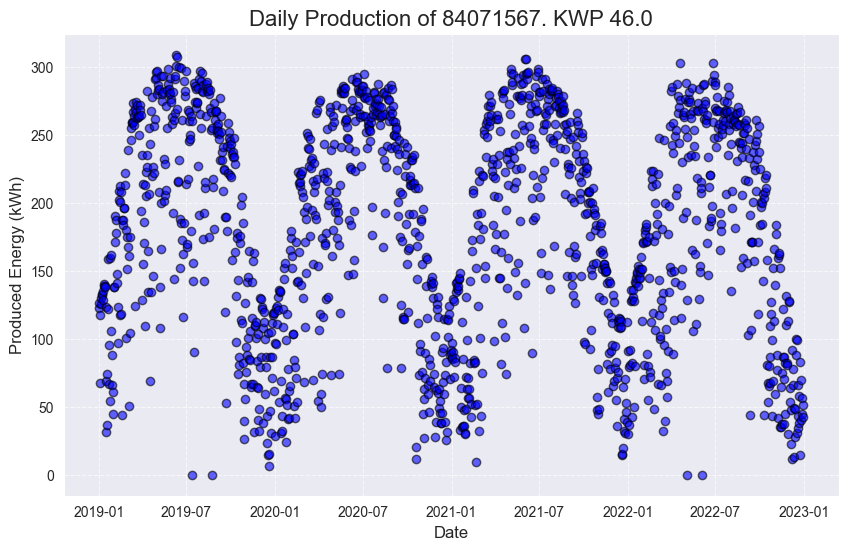

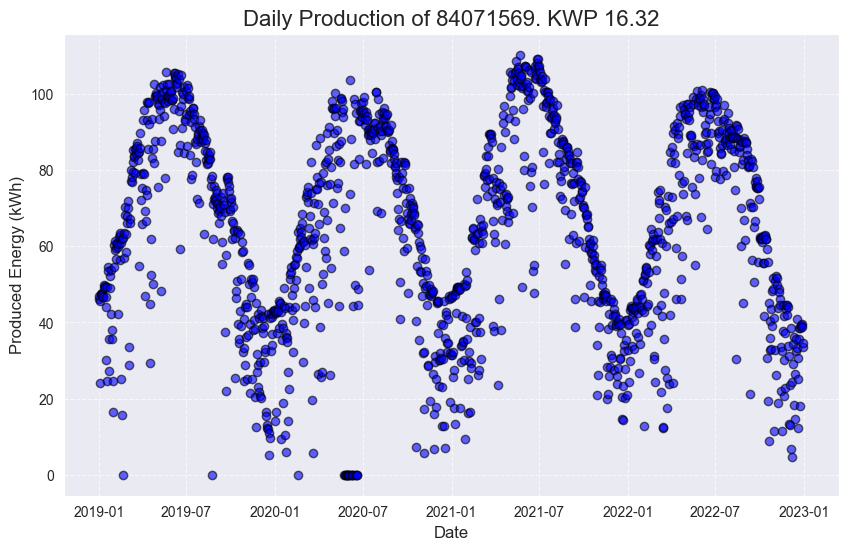

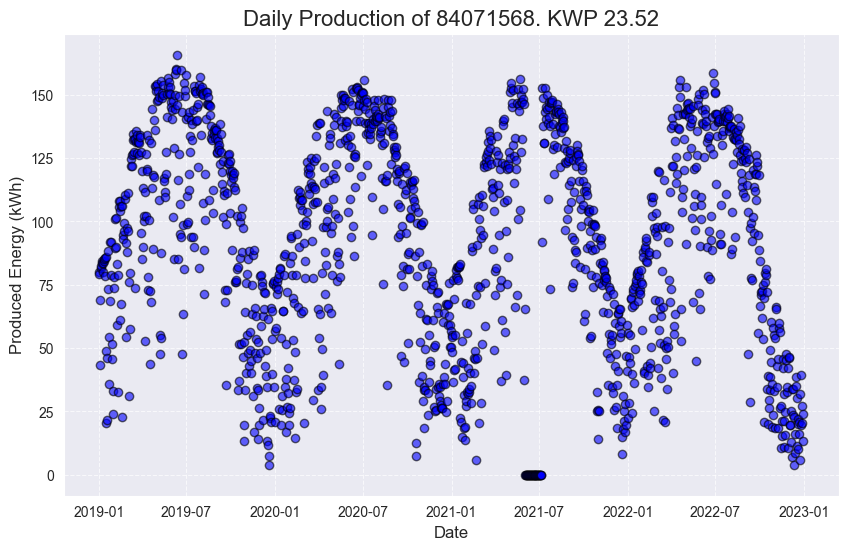

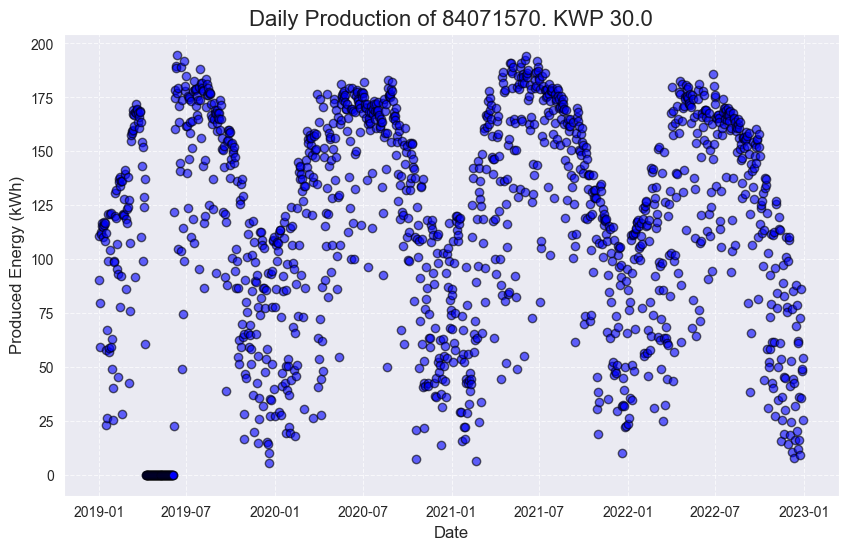

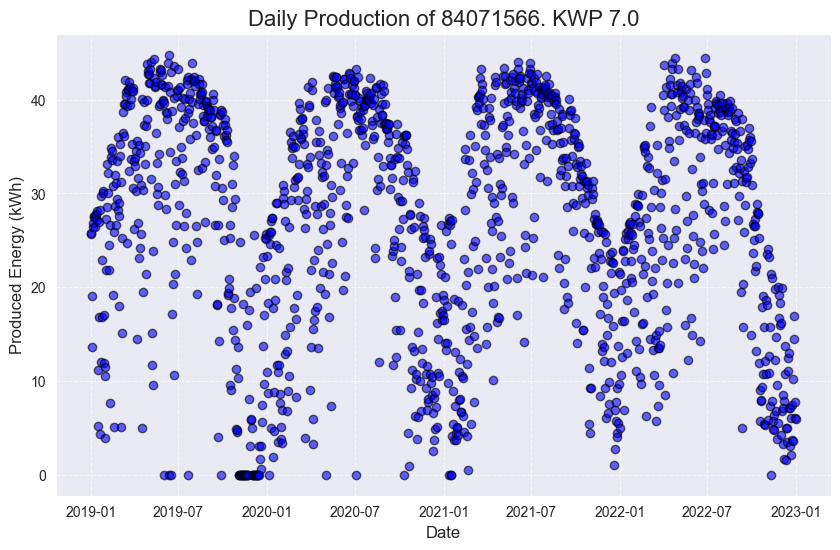

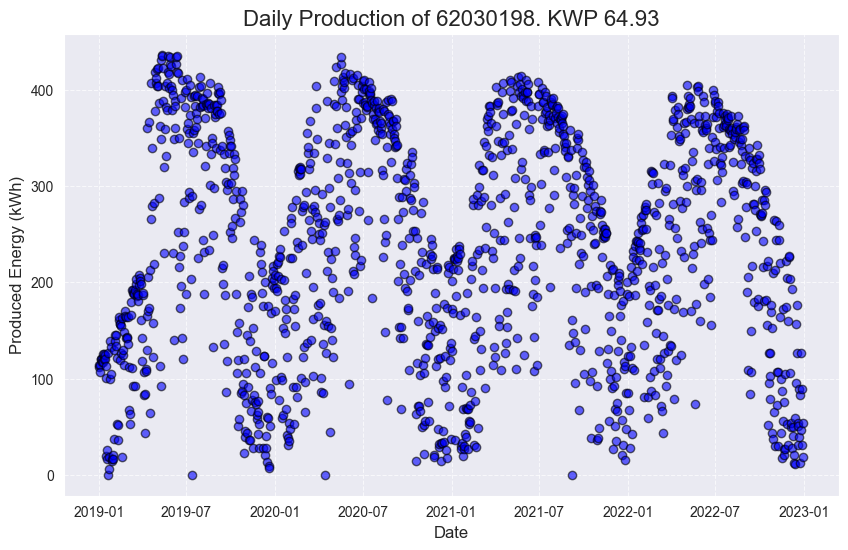

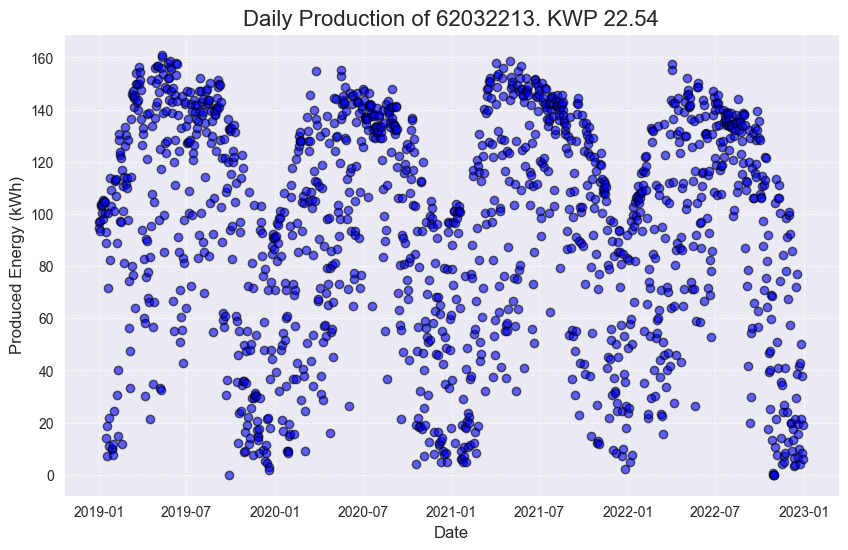

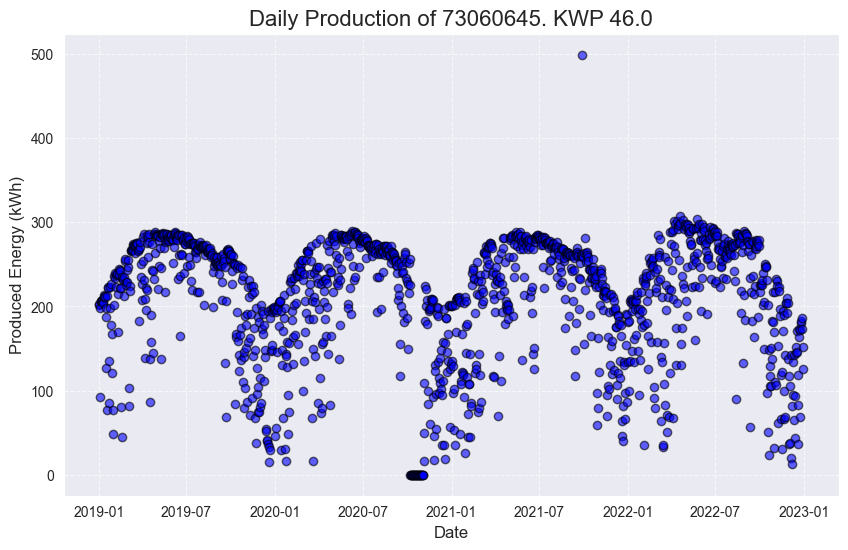

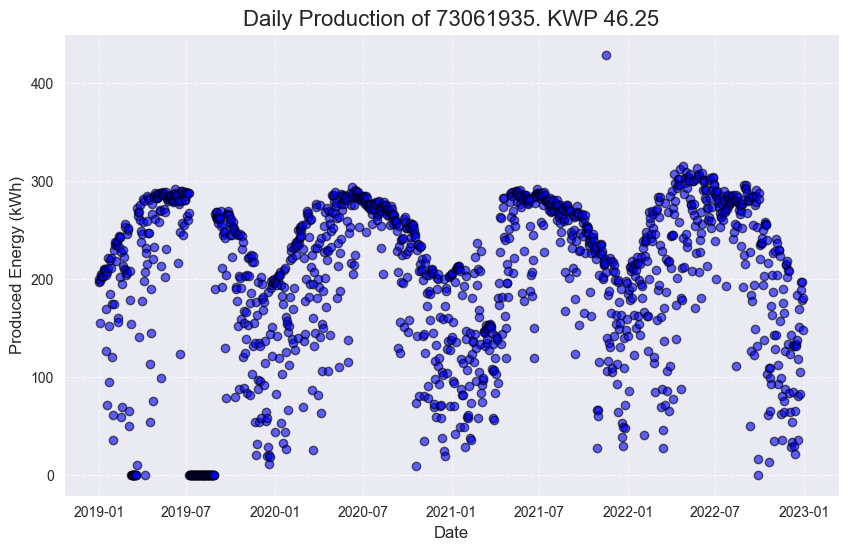

In [321]:
portugal_df["datetime"] = pd.to_datetime(portugal_df["datetime"])
portugal_df["serial"] = portugal_df["serial"].astype(str)
portugal_metadata["serial"] = portugal_metadata["serial"].astype(str)

for _, row in portugal_metadata.iterrows():
    serial = row['serial']
    kwp = row["kwp"]
    start_date = min(portugal_df[portugal_df["serial"] == serial]["datetime"])
    end_date = max(portugal_df[portugal_df["serial"] == serial]["datetime"])

    daily_data = calculate_daily_aggregates(portugal_df[portugal_df["serial"] == serial], 'datetime', 'produced energy')
    plot_scatter(data=daily_data, column_1='datetime', column_2='produced energy', title=f'Daily Production of {serial}. KWP {kwp}', x_label='Date', y_label='Produced Energy (kWh)')

### Data Cleaning

#### Clean Daily Data

In [322]:
# idea is to leave only daily data with production > 0
# since if during whole day production was 0 probably it's some error with sensors
# or PV plant was not working
# Also outliers are removed for each plant separately

portugal_df["datetime"] = pd.to_datetime(portugal_df["datetime"])
portugal_df["serial"] = portugal_df["serial"].astype(str)
portugal_metadata["serial"] = portugal_metadata["serial"].astype(str)

portugal_df_daily_cleaned = []
portugal_df_daily_outliers = []

for _, row in portugal_metadata.iterrows():
    serial = row['serial']

    daily_data = calculate_daily_aggregates(portugal_df[portugal_df["serial"] == serial], 'datetime', 'produced energy')
    daily_data = daily_data[daily_data["produced energy"] > 0]

    outliers = daily_data[daily_data["produced energy"] == 0]
    portugal_df_daily_outliers.append(outliers)

    daily_data, outliers = remove_outliers_isolation_forest(daily_data, features=['produced energy'], reason='outliers')

    daily_data["serial"] = serial
    daily_data["date"] = daily_data["datetime"].dt.date
    daily_data["date_serial"] = list(zip(daily_data["date"], daily_data["serial"]))

    portugal_df_daily_outliers.append(outliers)
    portugal_df_daily_cleaned.append(daily_data)


portugal_df_daily_cleaned = pd.concat(portugal_df_daily_cleaned)
portugal_df_daily_outliers = pd.concat(portugal_df_daily_outliers)

Original dataset size: (1457, 3)
Cleaned 72 due to outliers
Cleaned dataset size: (1385, 3)
Original dataset size: (1440, 3)
Cleaned 72 due to outliers
Cleaned dataset size: (1368, 3)
Original dataset size: (1427, 3)
Cleaned 71 due to outliers
Cleaned dataset size: (1356, 3)
Original dataset size: (1403, 3)
Cleaned 71 due to outliers
Cleaned dataset size: (1332, 3)
Original dataset size: (1417, 3)
Cleaned 71 due to outliers
Cleaned dataset size: (1346, 3)
Original dataset size: (1457, 3)
Cleaned 73 due to outliers
Cleaned dataset size: (1384, 3)
Original dataset size: (1457, 3)
Cleaned 70 due to outliers
Cleaned dataset size: (1387, 3)
Original dataset size: (1435, 3)
Cleaned 72 due to outliers
Cleaned dataset size: (1363, 3)
Original dataset size: (1395, 3)
Cleaned 70 due to outliers
Cleaned dataset size: (1325, 3)


In [323]:
# According to plot there is some data drift for plant with serial 62030198 from 2019-01-01 to 2019-07-01
portugal_df_daily_cleaned = portugal_df_daily_cleaned[~((portugal_df_daily_cleaned["serial"] == "62030198") & (portugal_df_daily_cleaned["date"] >= pd.to_datetime("2019-01-01").date()) & (portugal_df_daily_cleaned["date"] <= pd.to_datetime("2019-07-01").date()))]

### Clean Hourly Data

In [324]:
# leave based on daily data leave only hour data with daily production > 0
portugal_df["date"] = portugal_df["datetime"].dt.date
portugal_df["date_serial"] = list(zip(portugal_df["date"], portugal_df["serial"]))

portugal_df = portugal_df[portugal_df["date_serial"].isin(portugal_df_daily_cleaned["date_serial"])]

In [325]:
portugal_df_to_clean = portugal_df.copy()

filtered_logically_portugal_df, suspicious_data = filter_logical_inconsistencies(portugal_df_to_clean)

portugal_df_cleaned = filtered_logically_portugal_df.copy()

Initial dataset size: 290227
Removed 2251 rows due to POA > 75 but produced energy = 0
Removed 5837 rows due to POA = 0 but produced energy > 0


/var/folders/0l/34vn80296hlbbccw8h0n_3lr0000gn/T/ipykernel_85903/4120352041.py:86: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  suspicious_data = pd.concat([suspicious_data, suspicious], ignore_index=True)


Removed 5385 rows due to produced energy > 0 at night
Removed 1095 rows due to high shortwave_radiation + high cloud_cover conflict

Final dataset size after filtering: 275659
Total rows removed or modified: 14568
Suspicious (removed/modified) rows stored: 14568


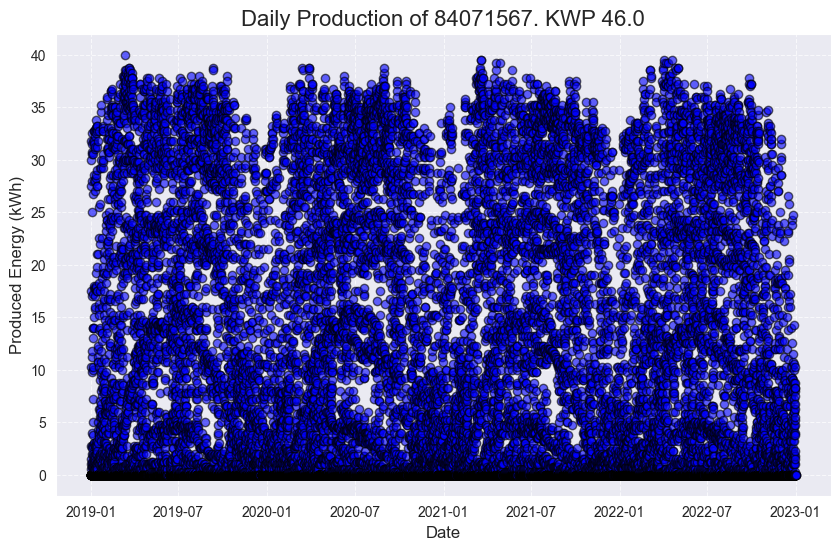

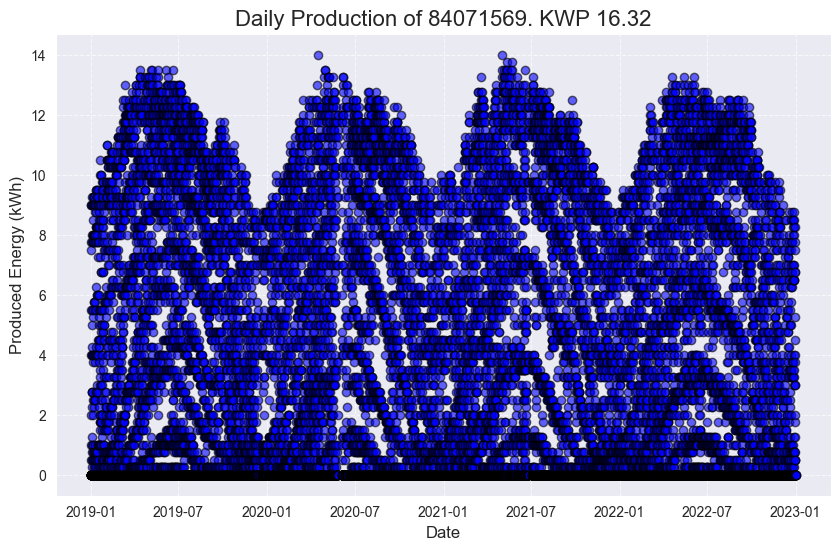

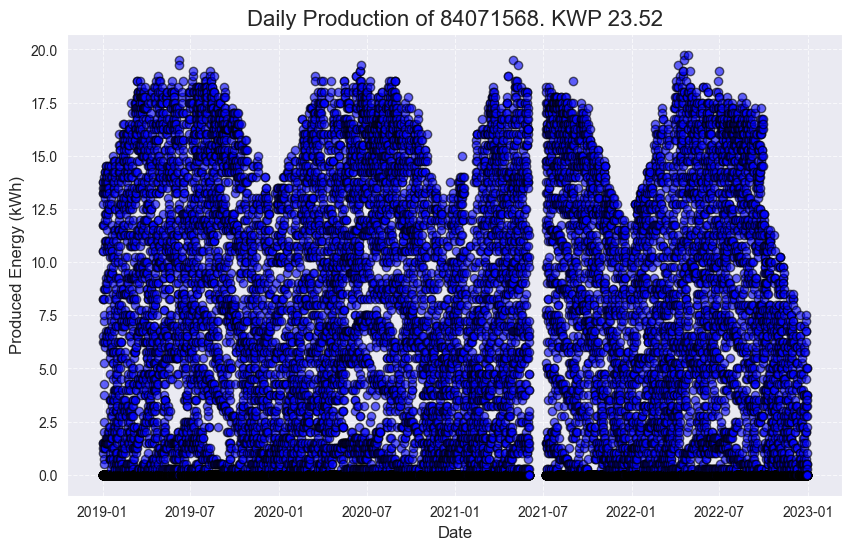

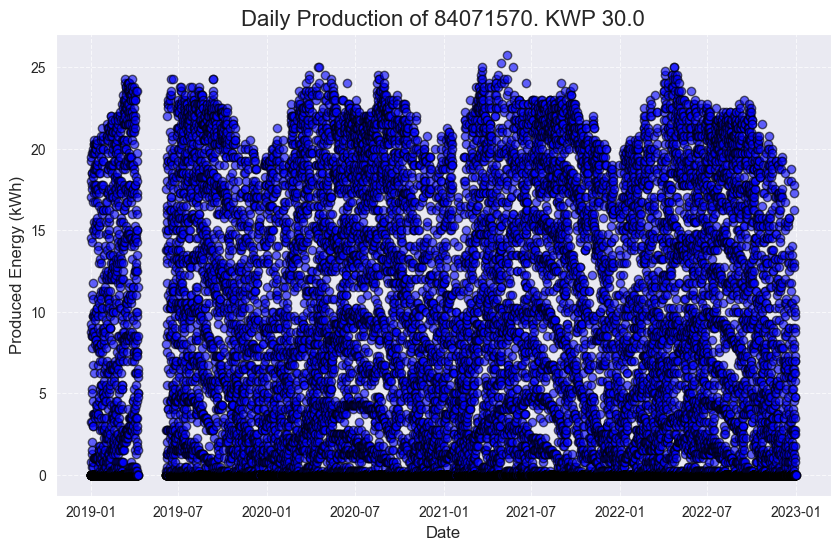

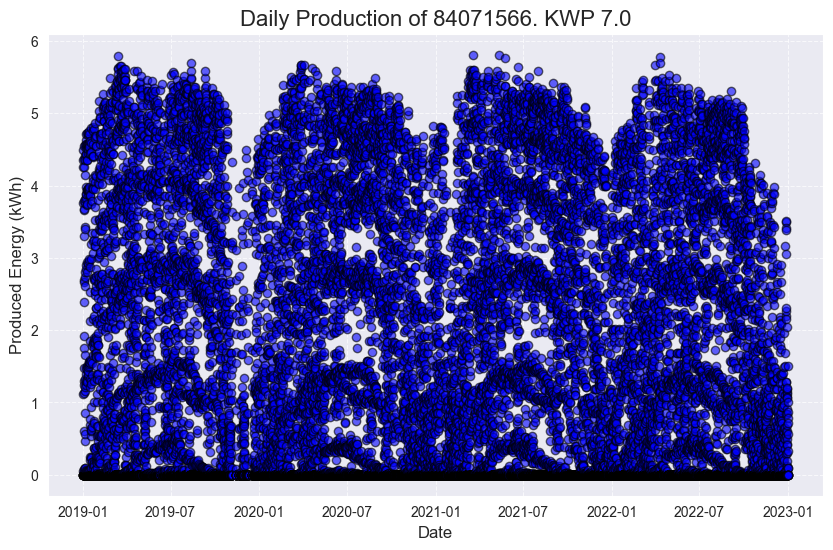

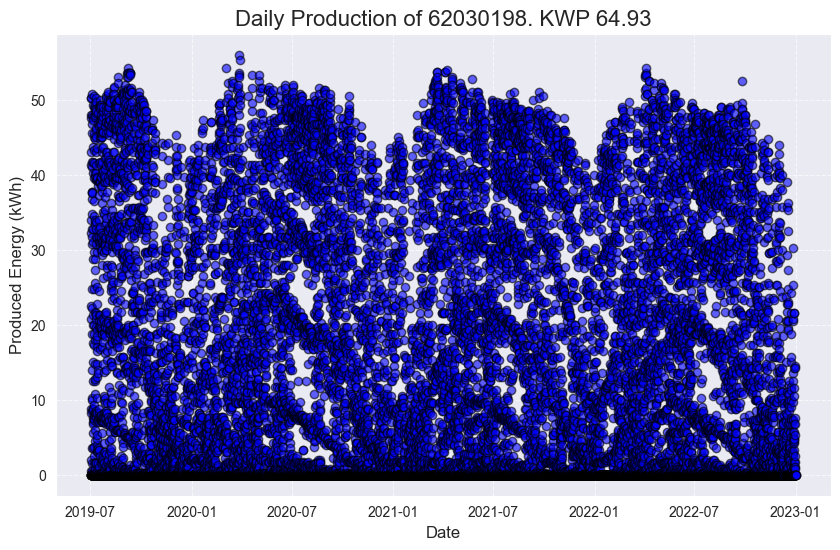

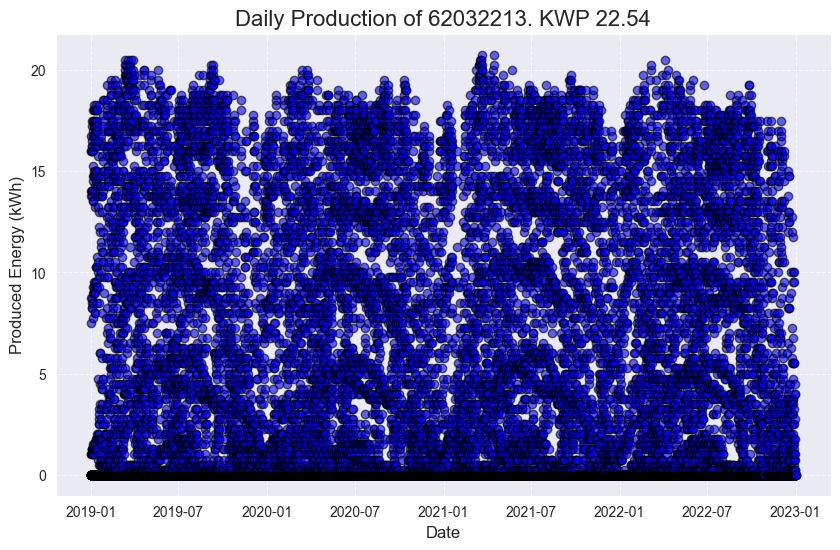

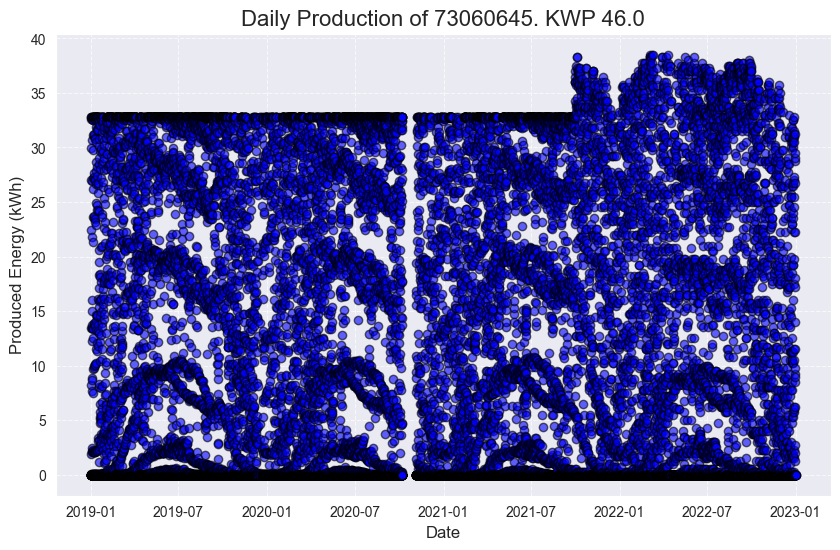

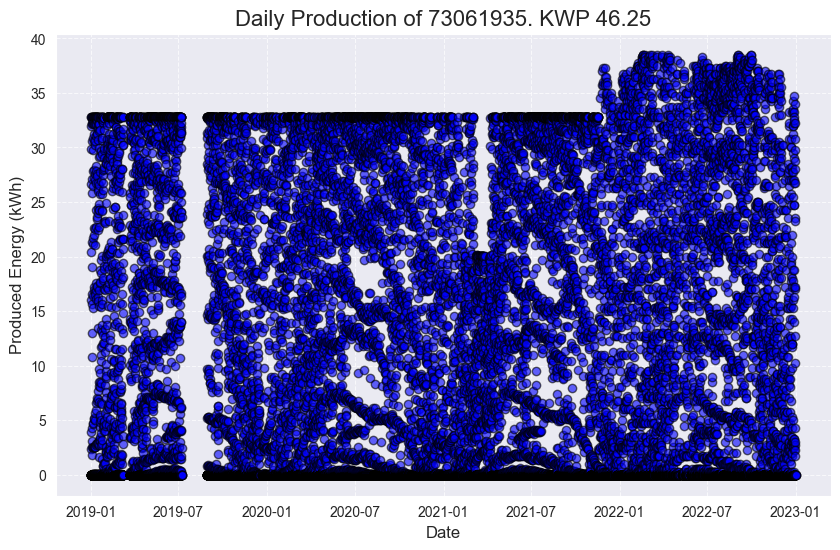

In [326]:
for _, row in portugal_metadata.iterrows():
    serial = row['serial']
    kwp = row["kwp"]

    plot_scatter(data=filtered_logically_portugal_df[filtered_logically_portugal_df["serial"] == serial], column_1='datetime', column_2='produced energy', title=f'Daily Production of {serial}. KWP {kwp}', x_label='Date', y_label='Produced Energy (kWh)')

In [327]:
# Drop weird plants 73061935, 73060645, since they don't show seasonal pattern and some of their output is capped

portugal_df_cleaned = portugal_df_cleaned[~portugal_df_cleaned["serial"].isin(["73061935", "73061945"])]

## UK

#### Clean Daily Data

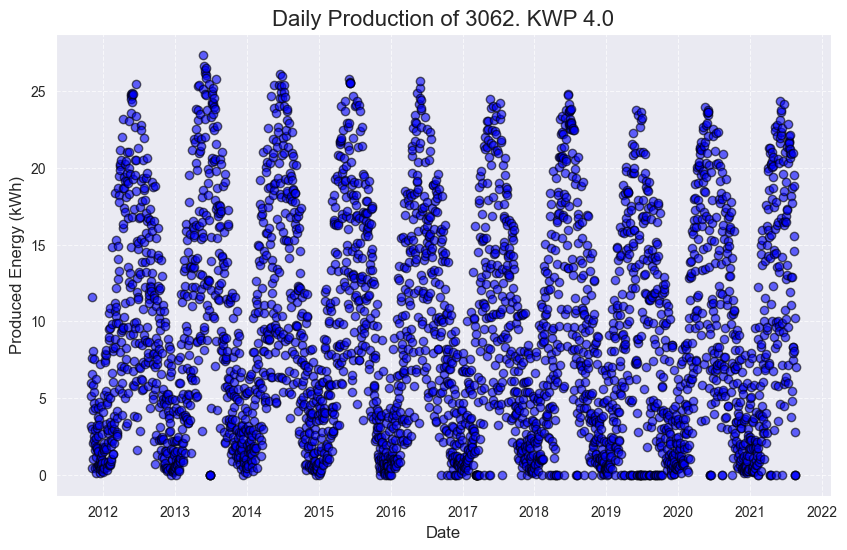

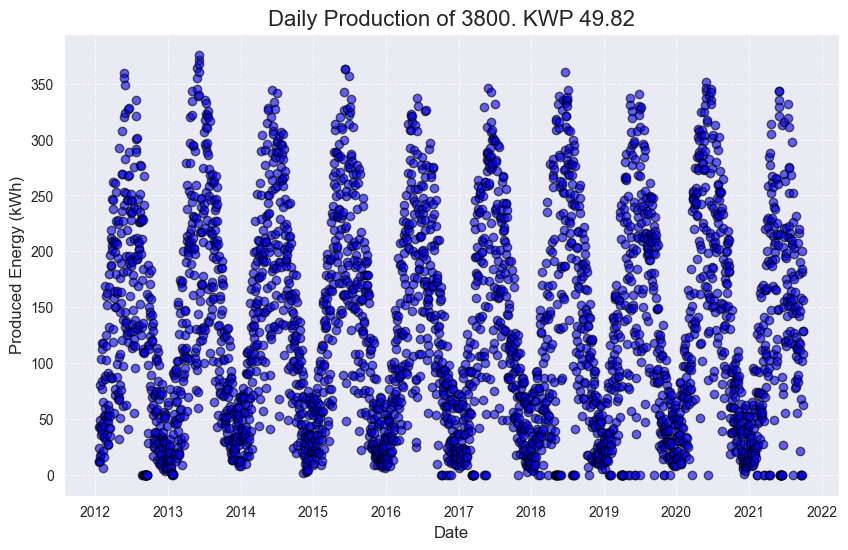

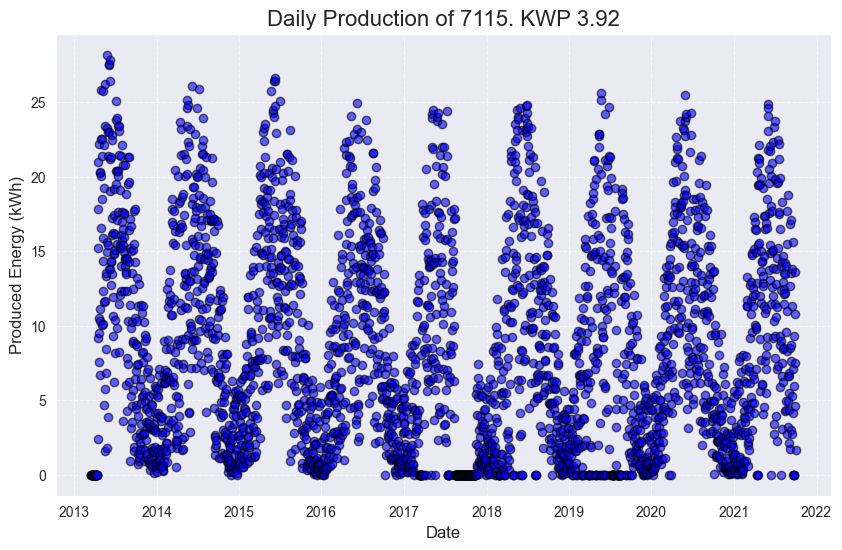

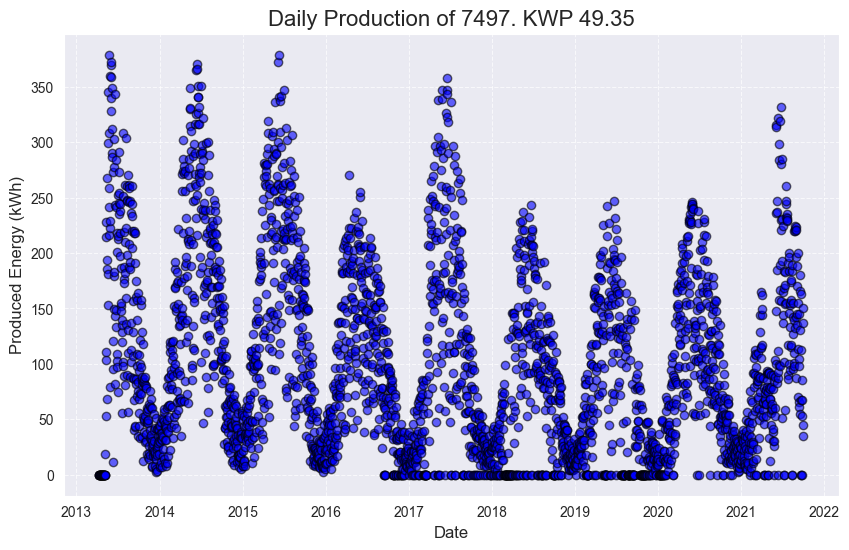

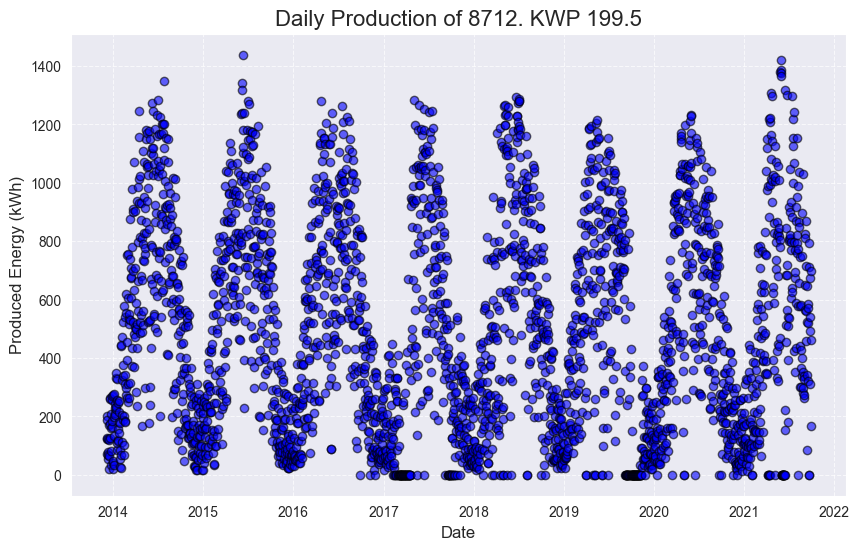

...

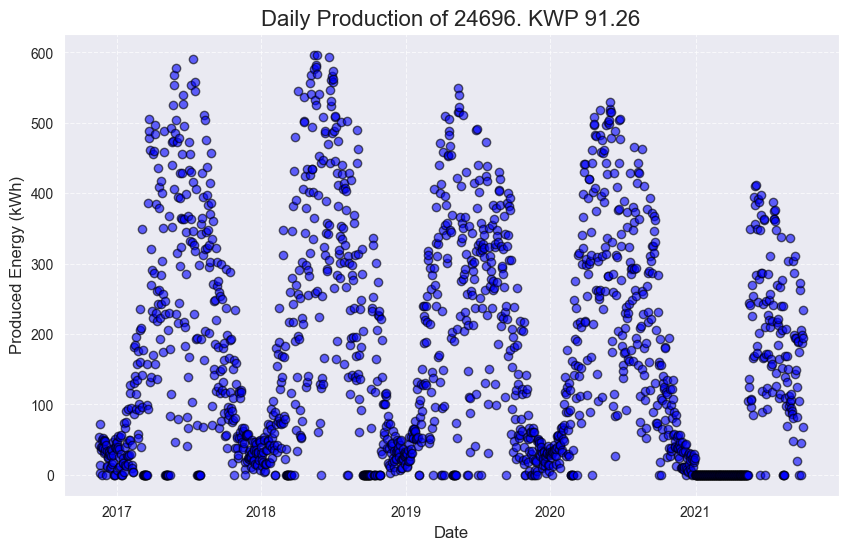

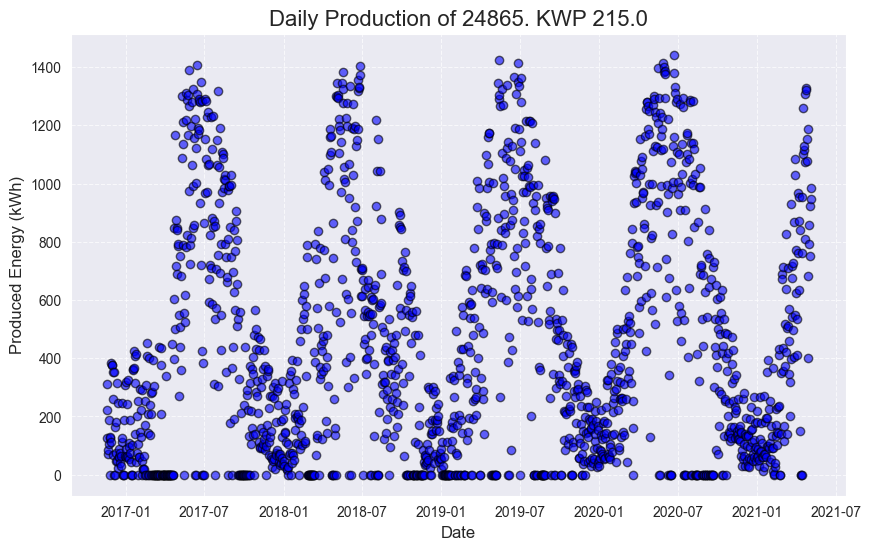

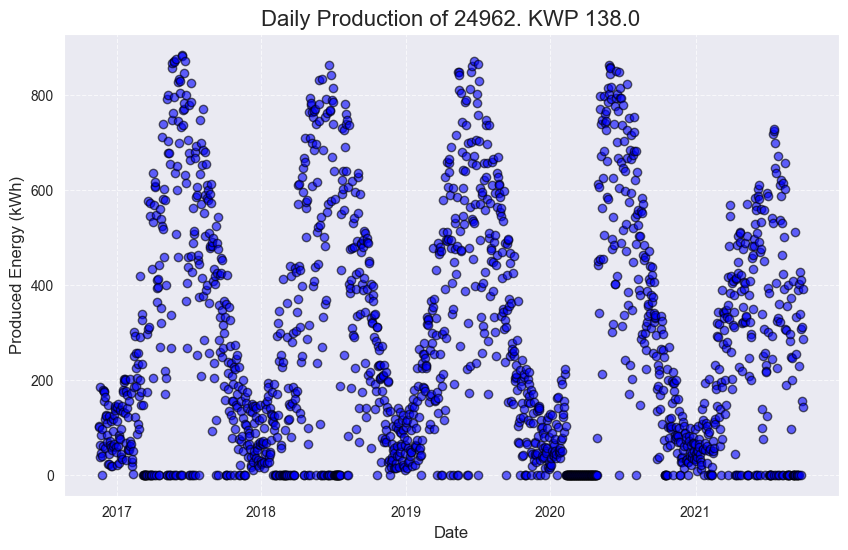

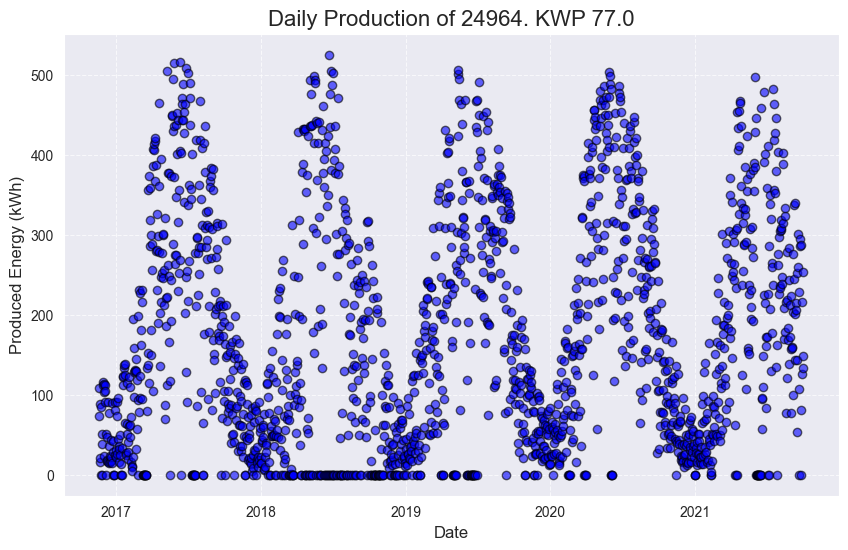

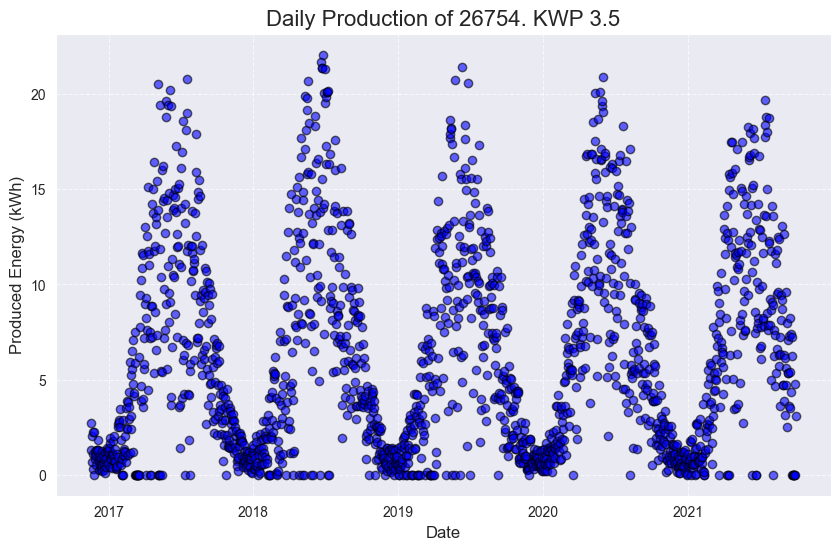

In [328]:
for _, row in uk_metadata.iterrows():
    serial = row['serial']
    kwp = row["kwp"]
    
    
    start_date = min(uk_df[uk_df["serial"] == serial]["datetime"])
    end_date = max(uk_df[uk_df["serial"] == serial]["datetime"])

    daily_data = calculate_daily_aggregates(uk_df[uk_df["serial"] == serial], 'datetime', 'produced energy')
    plot_scatter(data=daily_data, column_1='datetime', column_2='produced energy', title=f'Daily Production of {serial}. KWP {kwp}', x_label='Date', y_label='Produced Energy (kWh)')

In [329]:
# idea is to leave only daily data with production > 0
# since if during whole day production was 0 probably it's some error with sensors
# or PV plant was not working
# Also outliers are removed for each plant separately

uk_df["datetime"] = pd.to_datetime(uk_df["datetime"])
uk_df["serial"] = uk_df["serial"].astype(str)
uk_metadata["serial"] = uk_metadata["serial"].astype(str)

uk_df_daily_cleaned = []
uk_df_daily_outliers = []

for _, row in uk_metadata.iterrows():
    serial = row['serial']

    daily_data = calculate_daily_aggregates(uk_df[uk_df["serial"] == serial], 'datetime', 'produced energy')
    daily_data = daily_data[daily_data["produced energy"] > 0]

    outliers = daily_data[daily_data["produced energy"] == 0]
    uk_df_daily_outliers.append(outliers)

    daily_data, outliers = remove_outliers_isolation_forest(daily_data, features=['produced energy'], reason='outliers')

    daily_data["serial"] = serial
    daily_data["date"] = daily_data["datetime"].dt.date
    daily_data["date_serial"] = list(zip(daily_data["date"], daily_data["serial"]))

    uk_df_daily_outliers.append(outliers)
    uk_df_daily_cleaned.append(daily_data)


uk_df_daily_cleaned = pd.concat(uk_df_daily_cleaned)
uk_df_daily_outliers = pd.concat(uk_df_daily_outliers)

Original dataset size: (3471, 3)
Cleaned 173 due to outliers
Cleaned dataset size: (3298, 3)
Original dataset size: (3434, 3)
Cleaned 171 due to outliers
Cleaned dataset size: (3263, 3)
Original dataset size: (2866, 3)
Cleaned 143 due to outliers
Cleaned dataset size: (2723, 3)
Original dataset size: (2765, 3)
Cleaned 139 due to outliers
Cleaned dataset size: (2626, 3)
Original dataset size: (2681, 3)
Cleaned 134 due to outliers
Cleaned dataset size: (2547, 3)
Original dataset size: (2684, 3)
Cleaned 135 due to outliers
Cleaned dataset size: (2549, 3)
Original dataset size: (2504, 3)
Cleaned 126 due to outliers
Cleaned dataset size: (2378, 3)
Original dataset size: (1620, 3)
Cleaned 78 due to outliers
Cleaned dataset size: (1542, 3)
Original dataset size: (2122, 3)
Cleaned 107 due to outliers
Cleaned dataset size: (2015, 3)
Original dataset size: (1555, 3)
Cleaned 77 due to outliers
Cleaned dataset size: (1478, 3)
Original dataset size: (1516, 3)
Cleaned 75 due to outliers
Cleaned data

In [330]:
# Drop weird plants:
# 24865 has weird data from 01-01-2017 to 01-07-2017
# 19064 has scarce data after 2020
# 7497 has drop after 2018
# 24962 has highly volatile data after 2021
# 24964 also has highly volatile data after 2021
# 24696 has missing data after 2021
# 23524 has dropped production after 2021
# 10618 has low production from 2017 to 2019

uk_df_daily_cleaned = uk_df_daily_cleaned[~((uk_df_daily_cleaned["serial"] == "24865") & (uk_df_daily_cleaned["date"] >= pd.to_datetime("2016-01-01").date()) & (uk_df_daily_cleaned["date"] <= pd.to_datetime("2017-07-01").date()))]
uk_df_daily_cleaned = uk_df_daily_cleaned[~((uk_df_daily_cleaned["serial"] == "19064") & (uk_df_daily_cleaned["date"] >= pd.to_datetime("2020-01-01").date()))]
uk_df_daily_cleaned = uk_df_daily_cleaned[~((uk_df_daily_cleaned["serial"] == "7497") & (uk_df_daily_cleaned["date"] >= pd.to_datetime("2018-01-01").date()))]
uk_df_daily_cleaned = uk_df_daily_cleaned[~((uk_df_daily_cleaned["serial"] == "24962") & (uk_df_daily_cleaned["date"] >= pd.to_datetime("2021-01-01").date()))]
uk_df_daily_cleaned = uk_df_daily_cleaned[~((uk_df_daily_cleaned["serial"] == "24964") & (uk_df_daily_cleaned["date"] >= pd.to_datetime("2021-01-01").date()))]
uk_df_daily_cleaned = uk_df_daily_cleaned[~((uk_df_daily_cleaned["serial"] == "24696") & (uk_df_daily_cleaned["date"] >= pd.to_datetime("2021-01-01").date()))]
uk_df_daily_cleaned = uk_df_daily_cleaned[~((uk_df_daily_cleaned["serial"] == "23524") & (uk_df_daily_cleaned["date"] >= pd.to_datetime("2021-01-01").date()))]
uk_df_daily_cleaned = uk_df_daily_cleaned[~((uk_df_daily_cleaned["serial"] == "10618") & (uk_df_daily_cleaned["date"] >= pd.to_datetime("2017-01-01").date()) & (uk_df_daily_cleaned["date"] <= pd.to_datetime("2019-01-01").date()))]


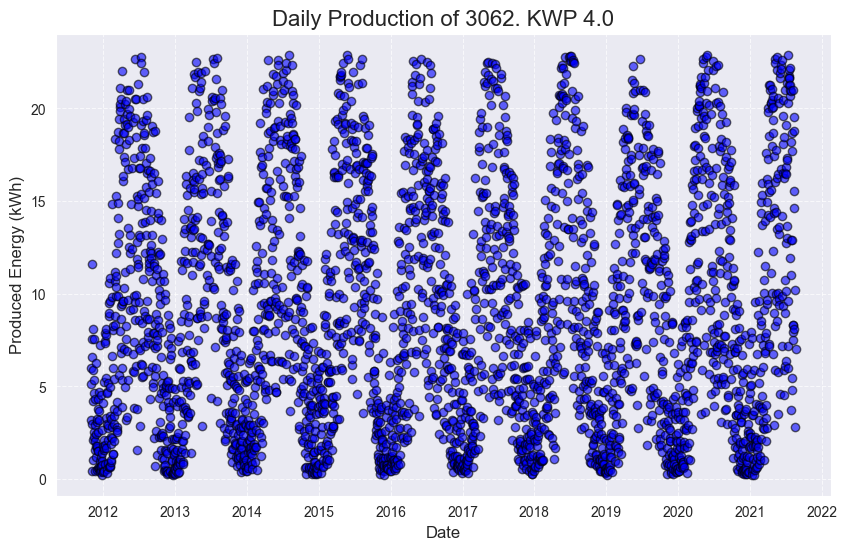

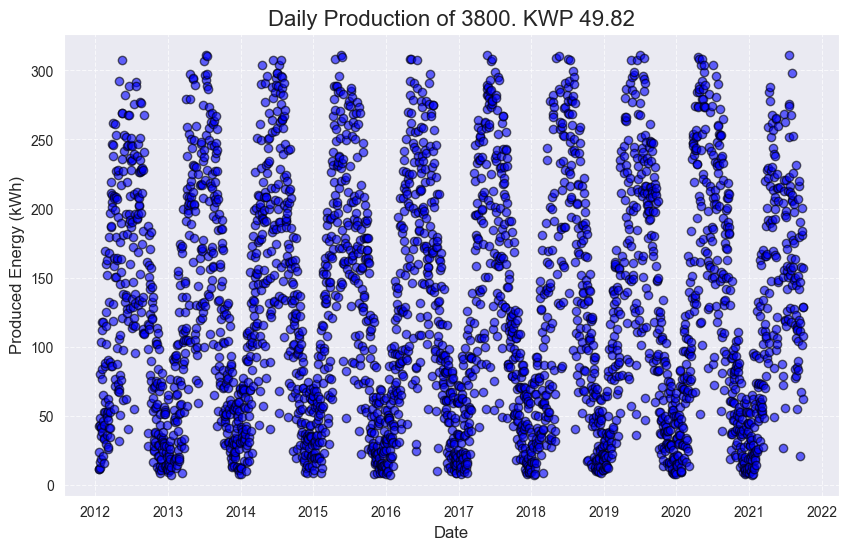

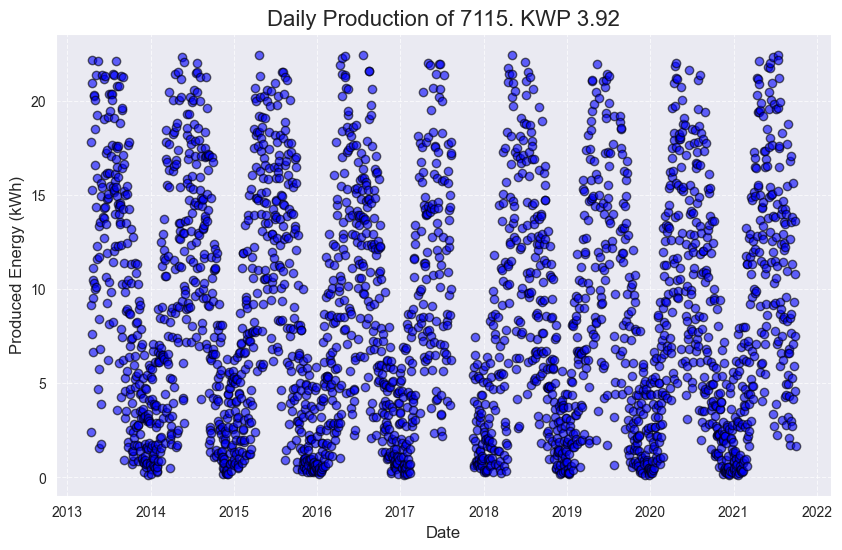

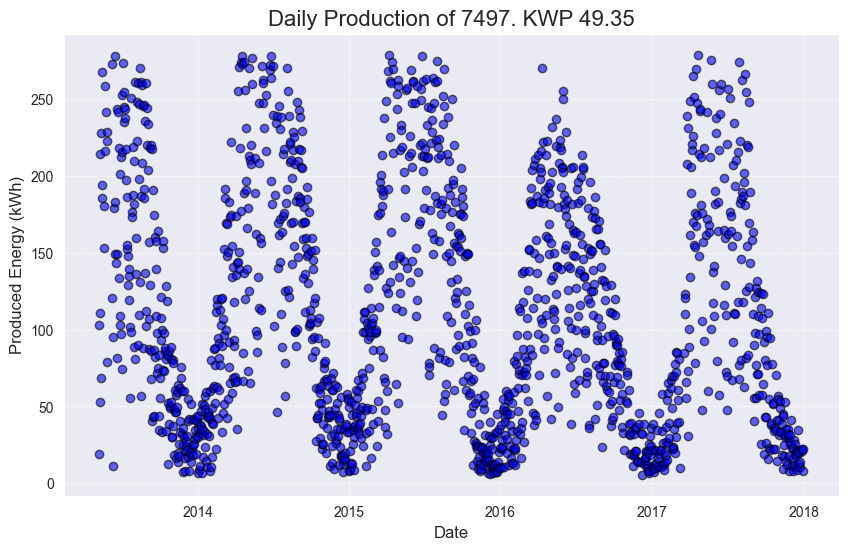

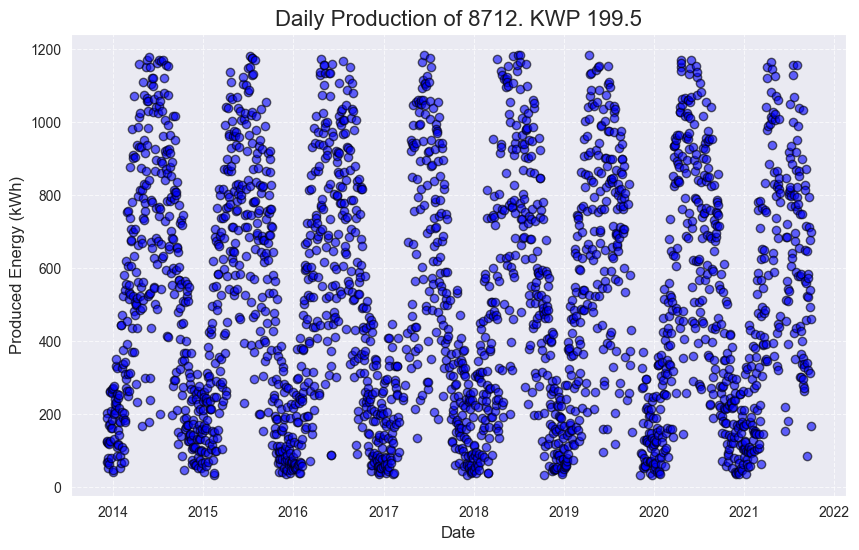

...

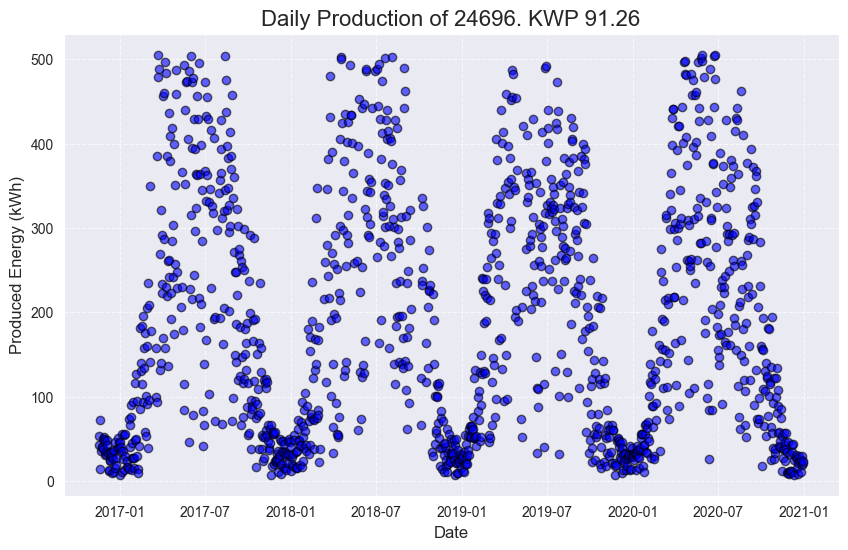

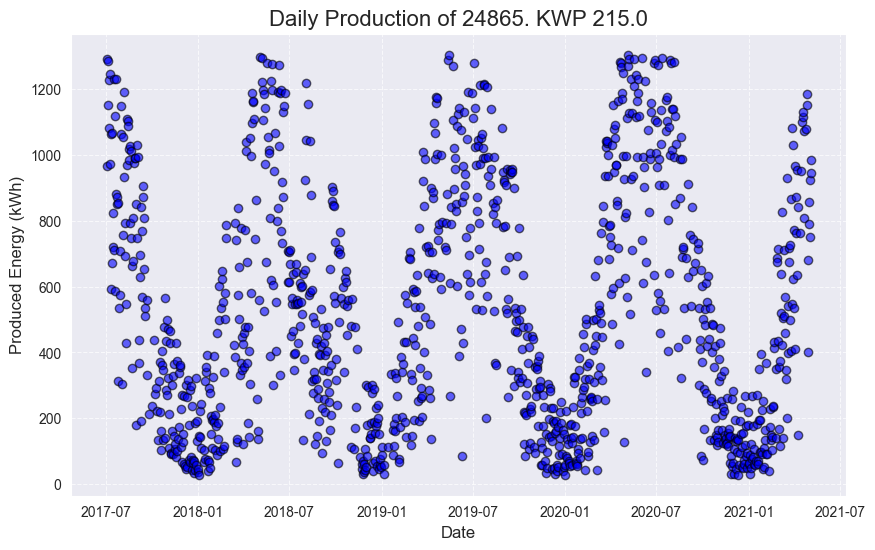

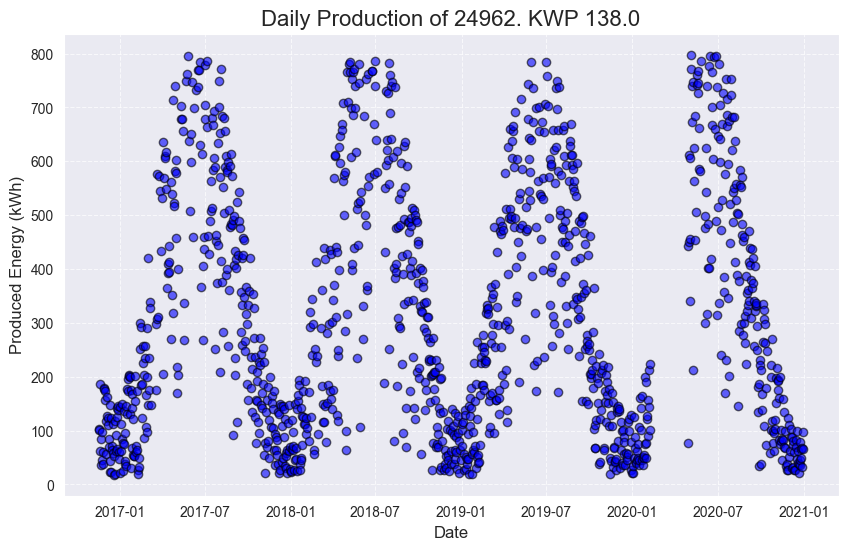

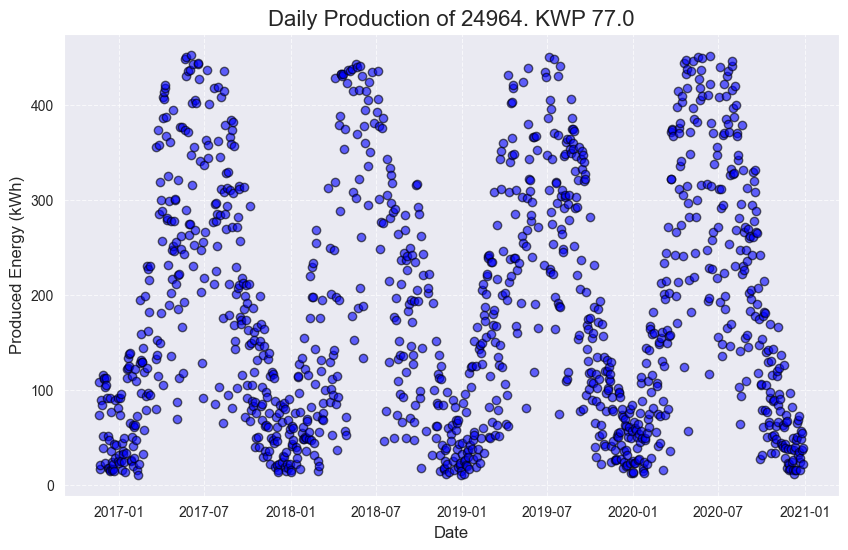

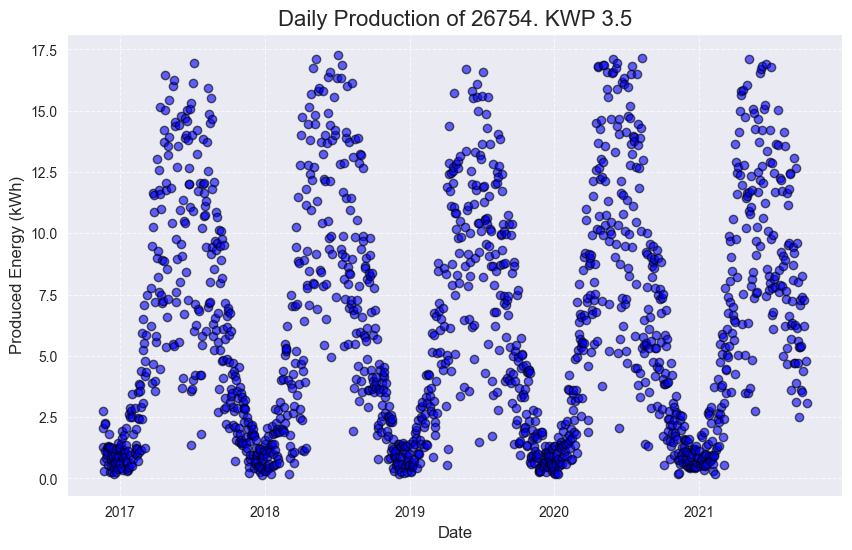

In [331]:
for _, row in uk_metadata.iterrows():
    serial = row['serial']

    if serial not in set(uk_df_daily_cleaned["serial"]):
        continue

    kwp = row["kwp"]
    start_date = min(uk_df_daily_cleaned[uk_df_daily_cleaned["serial"] == serial]["datetime"])
    end_date = max(uk_df_daily_cleaned[uk_df_daily_cleaned["serial"] == serial]["datetime"])

    selected_df = uk_df_daily_cleaned[uk_df_daily_cleaned["serial"] == serial]
    plot_scatter(data=selected_df, column_1='datetime', column_2='produced energy', title=f'Daily Production of {serial}. KWP {kwp}', x_label='Date', y_label='Produced Energy (kWh)')

# Clean Hourly Data Based on Daily

In [332]:
# leave based on daily data leave only hour data with daily production > 0
uk_df["date"] = uk_df["datetime"].dt.date
uk_df["date_serial"] = list(zip(uk_df["date"], uk_df["serial"]))

uk_df = uk_df[uk_df["date_serial"].isin(uk_df_daily_cleaned["date_serial"])]
uk_df_to_clean = uk_df.copy()

filtered_logically_uk_df, suspicious_data = filter_logical_inconsistencies(uk_df_to_clean)

uk_df_cleaned = filtered_logically_uk_df.copy()

Initial dataset size: 682440
Removed 1035 rows due to POA > 75 but produced energy = 0
Removed 20933 rows due to POA = 0 but produced energy > 0


/var/folders/0l/34vn80296hlbbccw8h0n_3lr0000gn/T/ipykernel_85903/4120352041.py:86: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  suspicious_data = pd.concat([suspicious_data, suspicious], ignore_index=True)


Removed 2 rows due to produced energy > 0 at night
Removed 2 rows due to high shortwave_radiation + high cloud_cover conflict

Final dataset size after filtering: 660468
Total rows removed or modified: 21972
Suspicious (removed/modified) rows stored: 21972


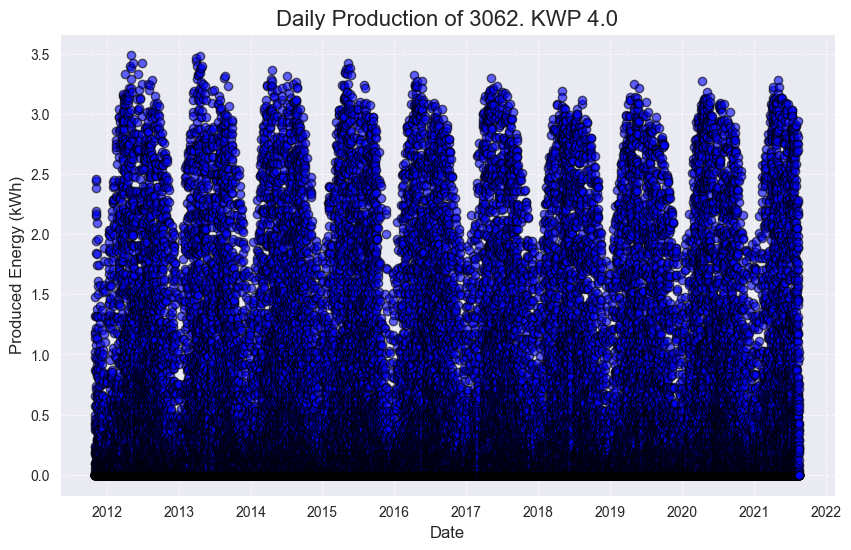

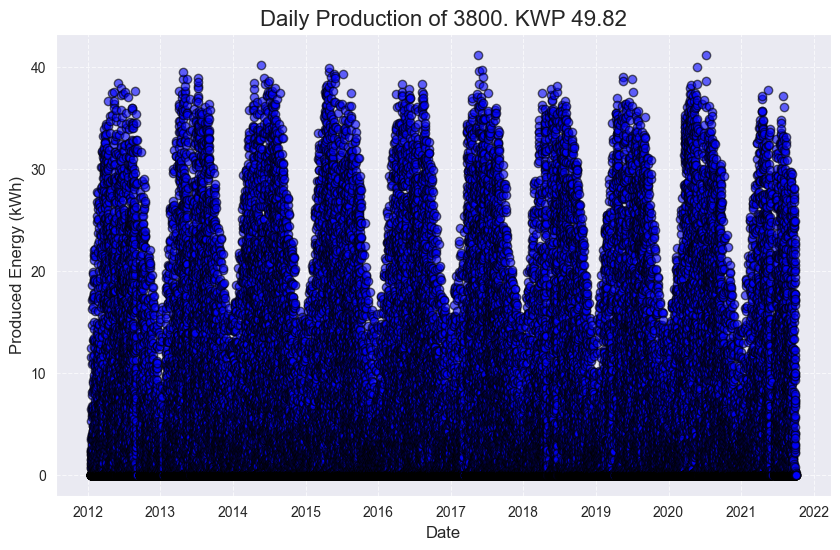

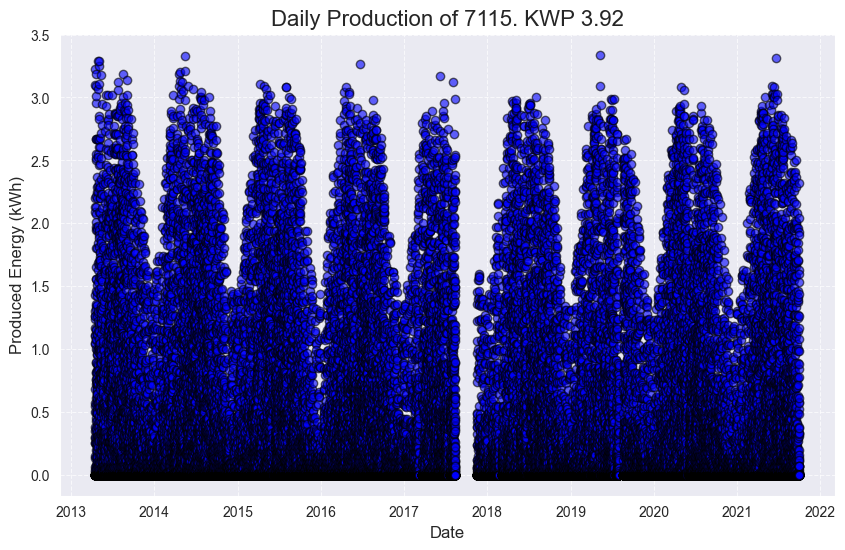

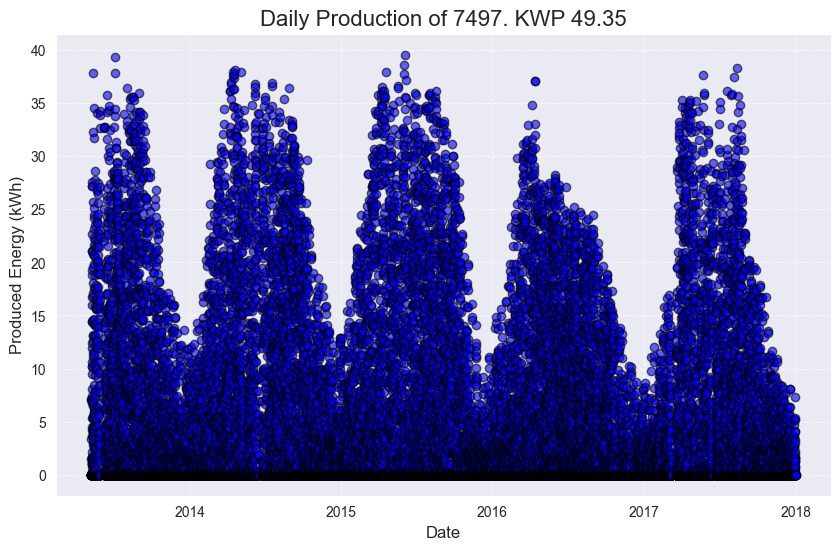

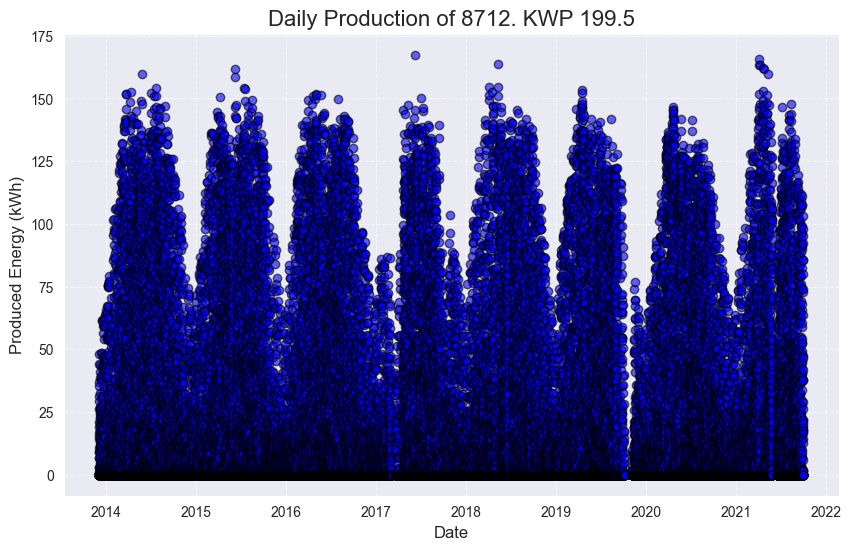

...

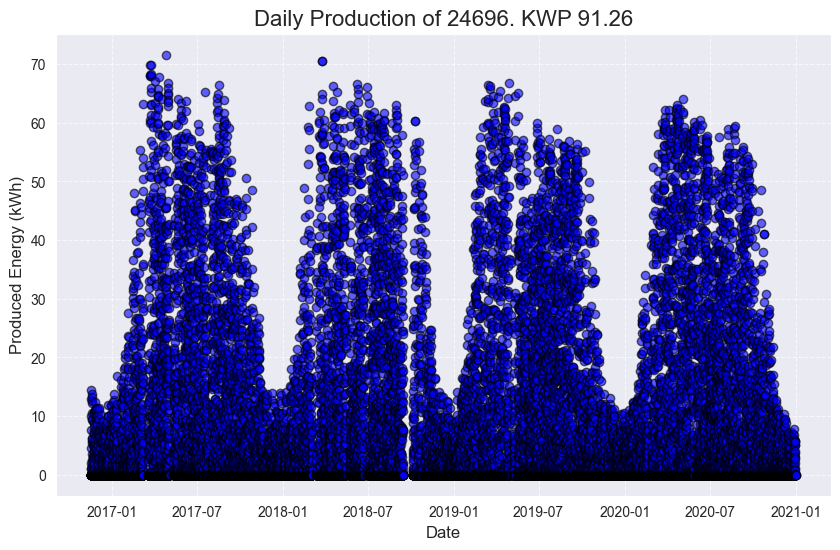

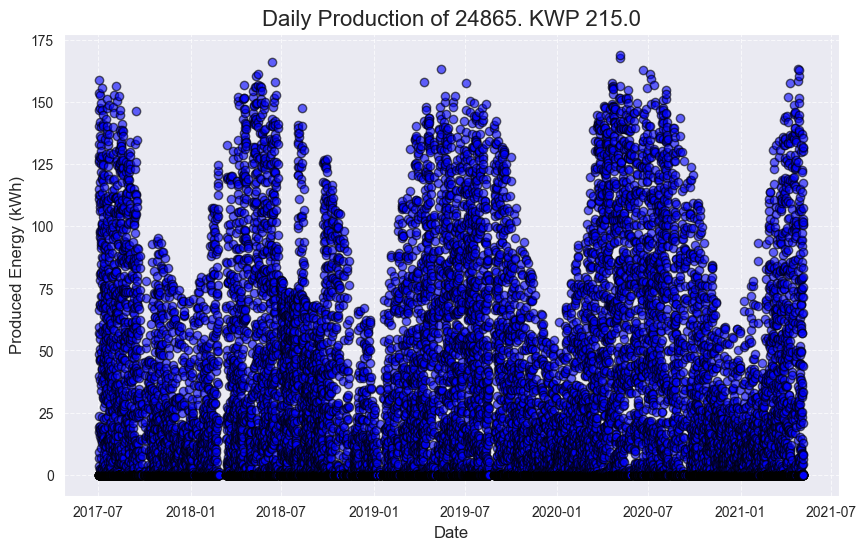

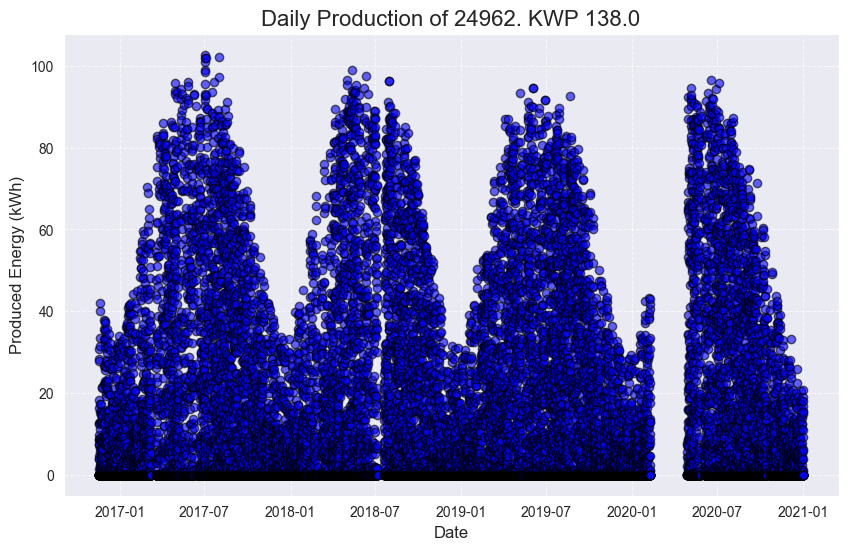

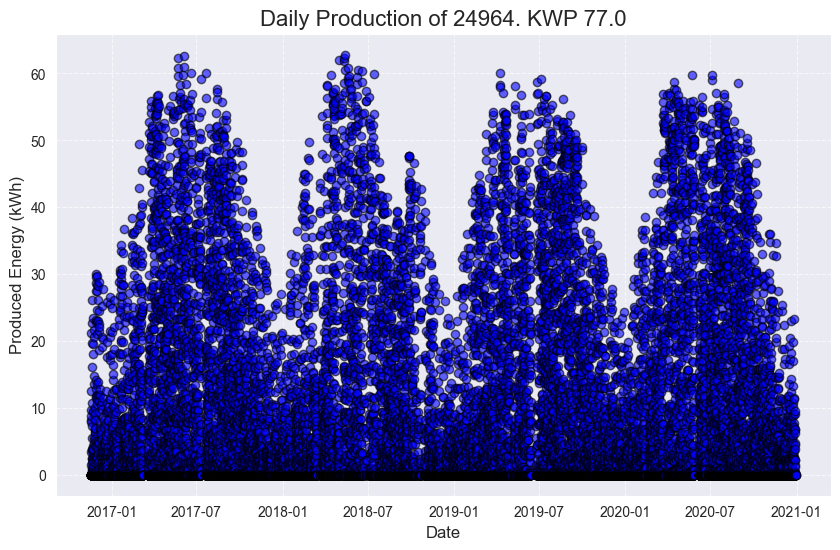

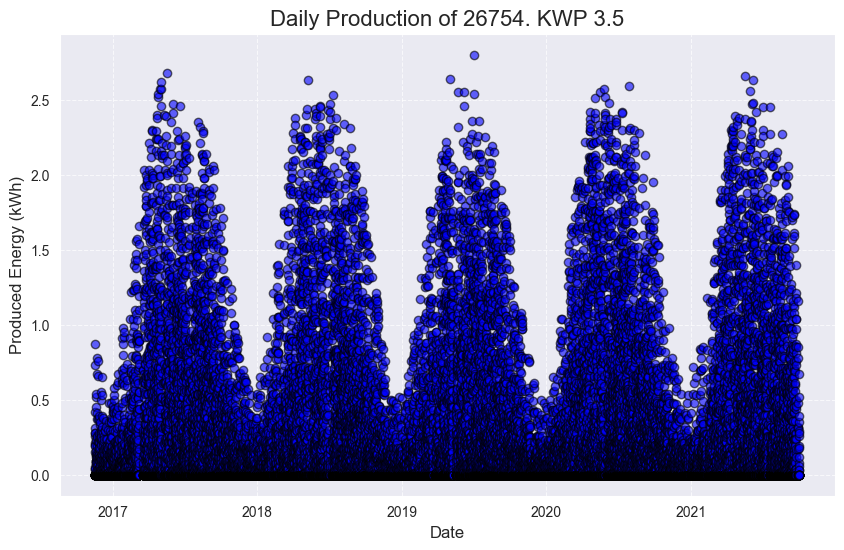

In [333]:
uk_metadata["serial"] = uk_metadata["serial"].astype(str)
uk_df_cleaned["serial"] = uk_df_cleaned["serial"].astype(str)
uk_df_cleaned["datetime"] = pd.to_datetime(uk_df_cleaned["datetime"])

for _, row in uk_metadata.iterrows():
    serial = row['serial']
    kwp = row["kwp"]

    if serial not in set(uk_df_cleaned["serial"]):
        continue

    plot_scatter(data=uk_df_cleaned[uk_df_cleaned["serial"] == serial], column_1='datetime', column_2='produced energy', title=f'Daily Production of {serial}. KWP {kwp}', x_label='Date', y_label='Produced Energy (kWh)')

In [334]:
# Drop weird plants:
# 7497 has drop between 01-05-2016 and 01-09-2016
# 24865 has incomplete data between 01-07-2018 and 01-01-2019


uk_df_cleaned = uk_df_cleaned[~((uk_df_cleaned["serial"] == "7497") & (uk_df_cleaned["datetime"] >= pd.to_datetime("2016-05-01")) & (uk_df_cleaned["datetime"] <= pd.to_datetime("2016-09-01")))]
uk_df_cleaned = uk_df_cleaned[~((uk_df_cleaned["serial"] == "24865") & (uk_df_cleaned["datetime"] >= pd.to_datetime("2018-07-01")) & (uk_df_cleaned["datetime"] <= pd.to_datetime("2019-01-01")))]


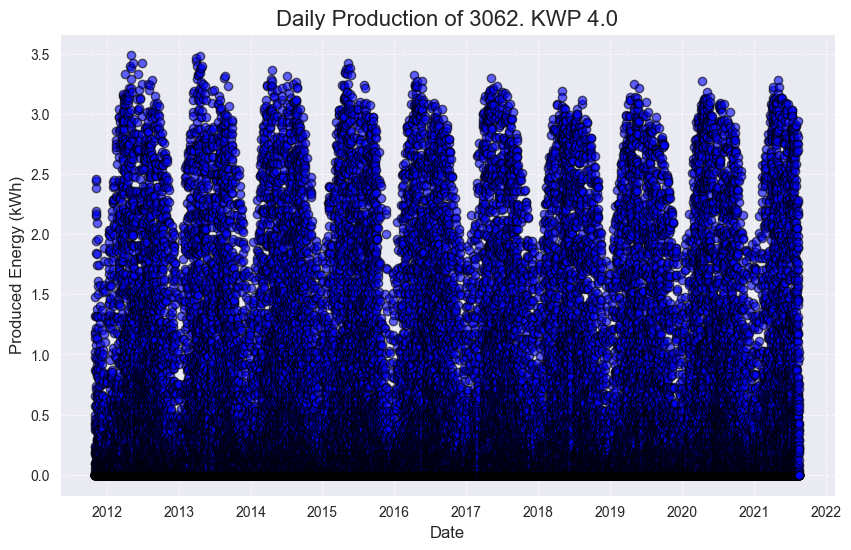

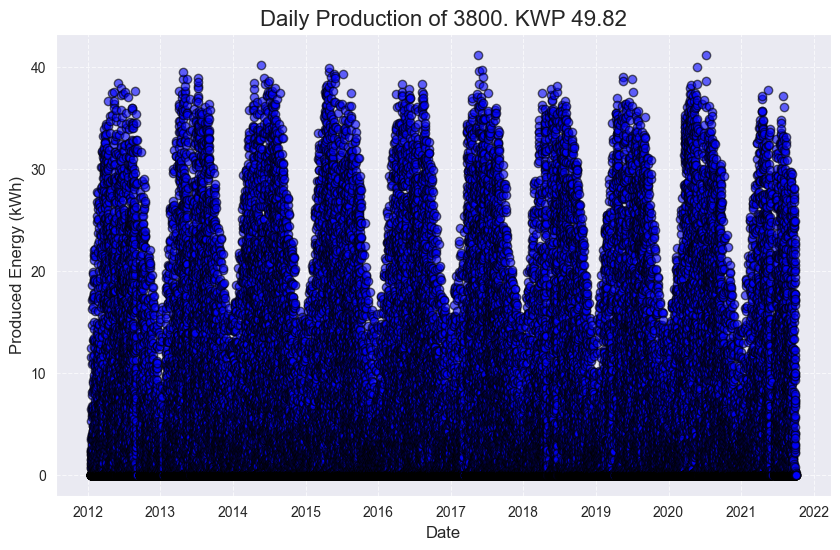

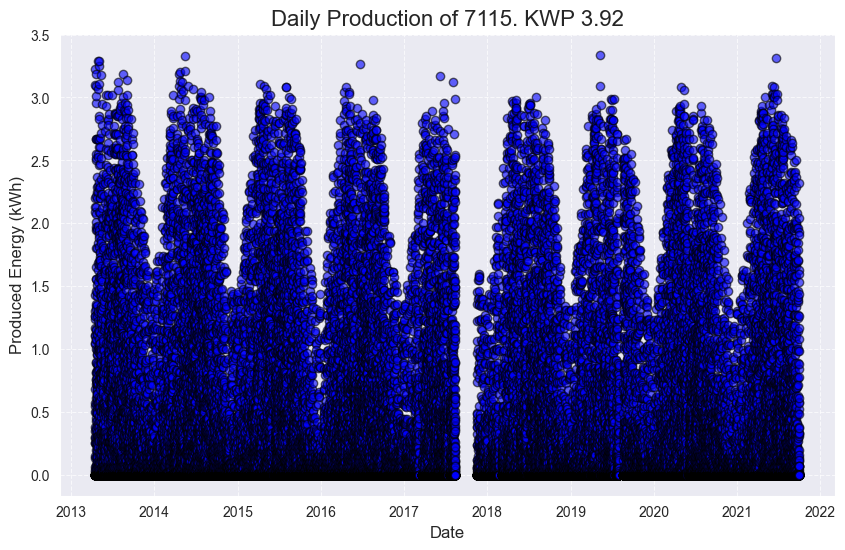

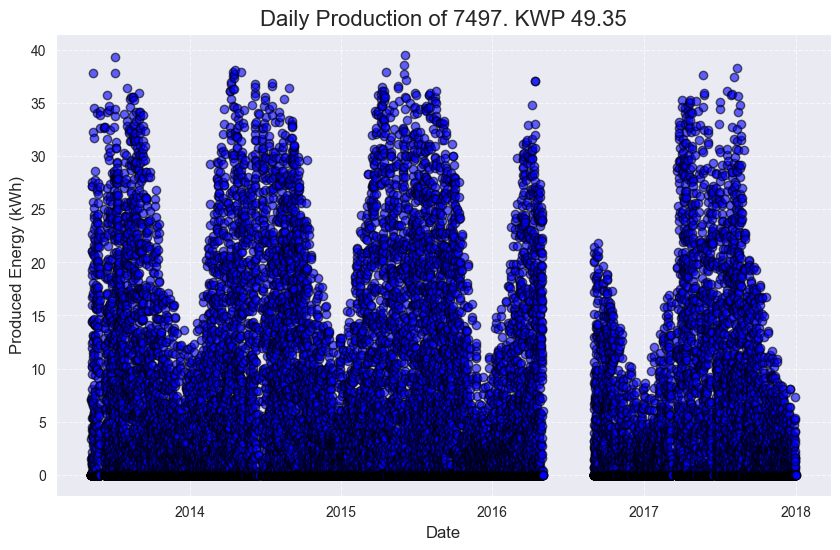

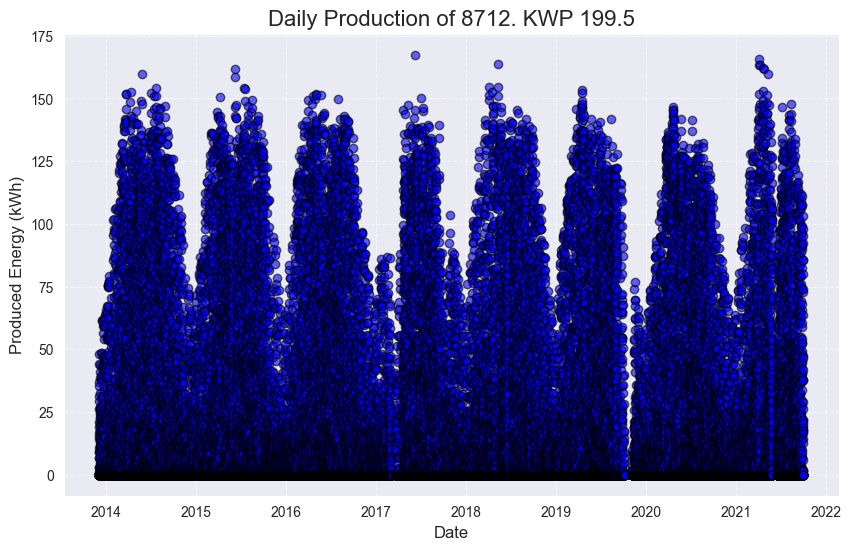

...

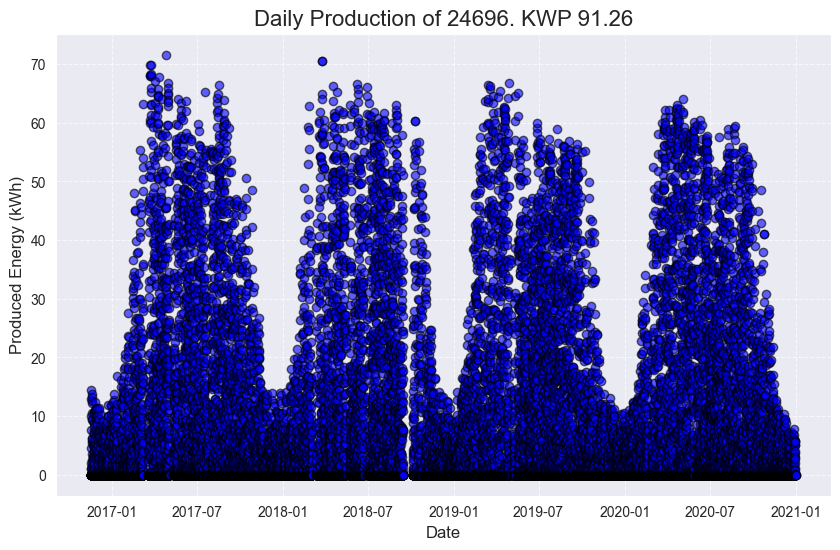

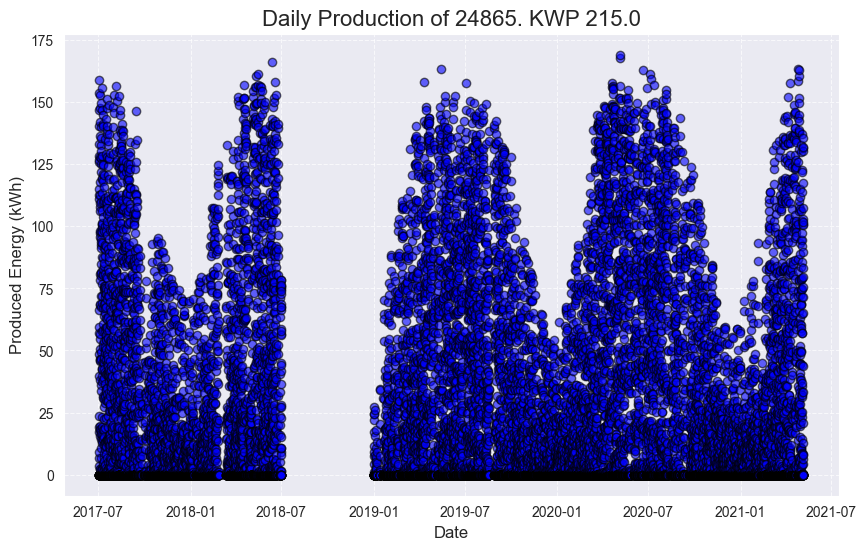

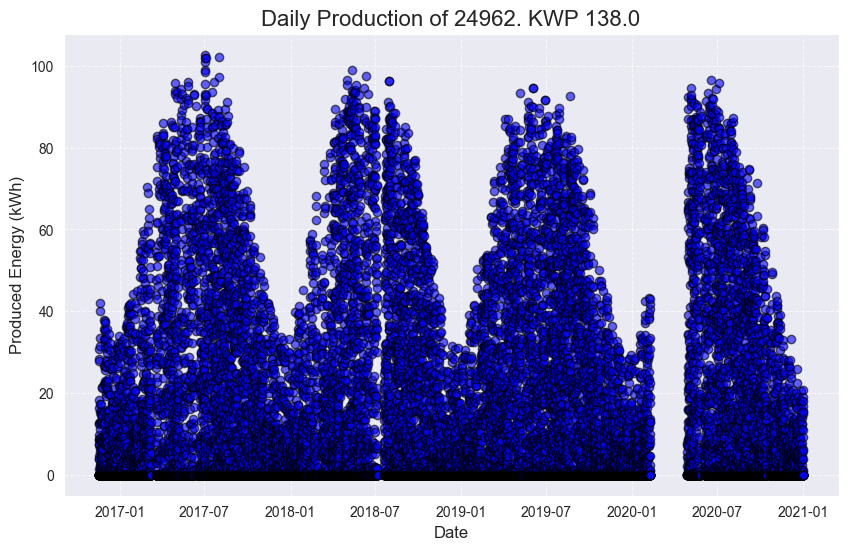

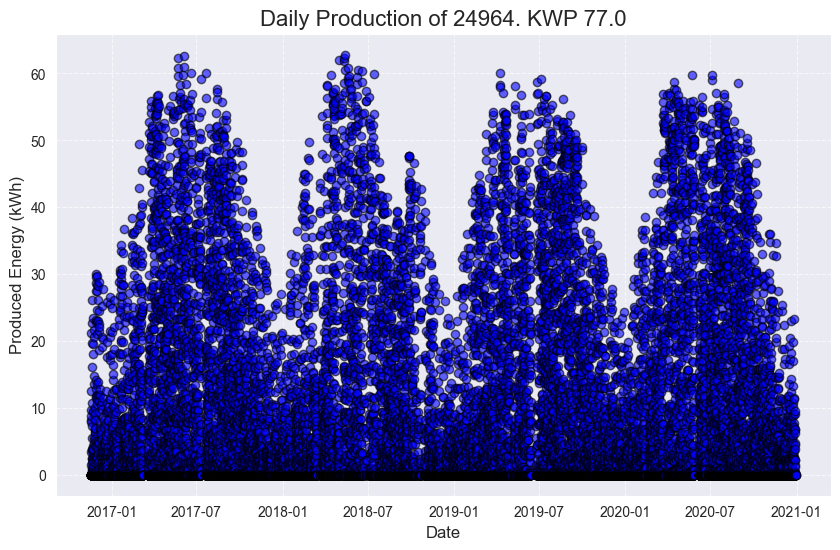

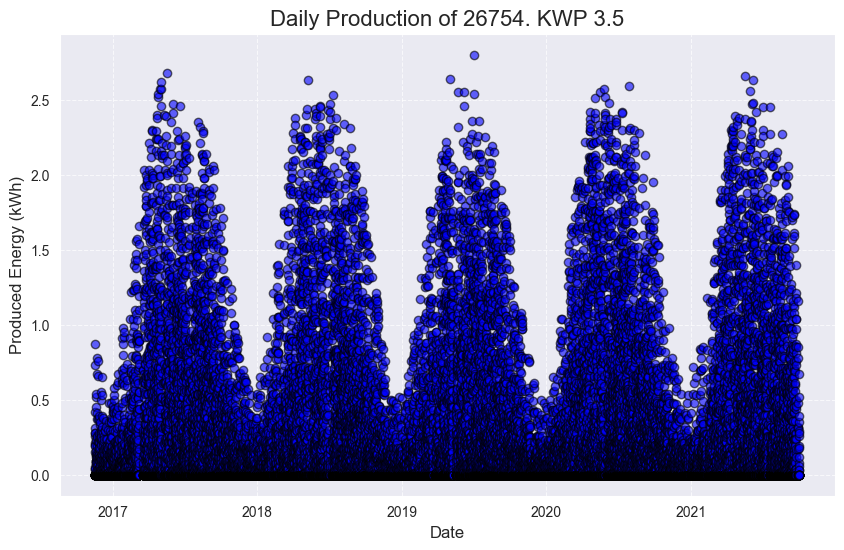

In [335]:
uk_metadata["serial"] = uk_metadata["serial"].astype(str)
uk_df_cleaned["serial"] = uk_df_cleaned["serial"].astype(str)
uk_df_cleaned["datetime"] = pd.to_datetime(uk_df_cleaned["datetime"])


for _, row in uk_metadata.iterrows():
    serial = row['serial']
    kwp = row["kwp"]

    if serial not in set(uk_df_cleaned["serial"]):
        continue

    plot_scatter(data=uk_df_cleaned[uk_df_cleaned["serial"] == serial], column_1='datetime', column_2='produced energy', title=f'Daily Production of {serial}. KWP {kwp}', x_label='Date', y_label='Produced Energy (kWh)')

# Remove Unnecessary Columns

In [336]:
# manually remove columns that were temporary or not needed
# "date", "date_serial" were created to join data back
#  terrestrial_radiation and apparent_temperature are not relevant
# et0_fao_evapotranspiration is not relevant
# joules wasn't used since another check was done
# uk dataset has no name column
portugal_df_cleaned = portugal_df_cleaned.drop(columns=["date", "date_serial", "name", "terrestrial_radiation", "joules", "apparent_temperature", "et0_fao_evapotranspiration"])

In [337]:
uk_df_cleaned = uk_df_cleaned.drop(columns=["date", "date_serial", "terrestrial_radiation", "joules", "apparent_temperature", "et0_fao_evapotranspiration"])

# Remove Outliers

## Portugal

In [338]:
portugal_df_to_remove_outliers = portugal_df_cleaned.copy()

feature_sets = {
    "weather": ['shortwave_radiation', 'poa', 'clearsky_index', 'cloud_cover',
    'temperature_2m', 'relative_humidity_2m'],
    "performance": ['produced energy', 'poa', 'clearsky_index', 'kwp'],
    "combined": ['shortwave_radiation', 'cloud_cover', 'temperature_2m', 'produced energy', 'poa', 'clearsky_index']
}

portugal_isolation_forest_df = portugal_df_to_remove_outliers.copy()
portugal_isolation_forest_outliers = []
for feature_set in feature_sets:
    portugal_isolation_forest_df, outliers = remove_outliers_isolation_forest(portugal_isolation_forest_df, features=feature_sets[feature_set], reason=f"{feature_set} outliers", contamination=0.02)
    portugal_isolation_forest_outliers.append(outliers)

portugal_isolation_forest_outliers = pd.concat(portugal_isolation_forest_outliers, ignore_index=True)

portugal_df_cleaned = portugal_isolation_forest_df.copy()

Original dataset size: (245716, 46)
Cleaned 4915 due to weather outliers
Cleaned dataset size: (240801, 46)
Original dataset size: (240801, 46)
Cleaned 4816 due to performance outliers
Cleaned dataset size: (235985, 46)
Original dataset size: (235985, 46)
Cleaned 4720 due to combined outliers
Cleaned dataset size: (231265, 46)


# UK

In [339]:
uk_df_to_remove_outliers = uk_df_cleaned.copy()

feature_sets = {
    "weather": ['shortwave_radiation', 'poa', 'clearsky_index', 'cloud_cover',
    'temperature_2m', 'relative_humidity_2m'],
    "performance": ['produced energy', 'poa', 'clearsky_index', 'kwp'],
    "combined": ['shortwave_radiation', 'cloud_cover', 'temperature_2m', 'produced energy', 'poa', 'clearsky_index']
}

uk_isolation_forest_df = uk_df_to_remove_outliers.copy()

uk_isolation_forest_outliers = []
for feature_set in feature_sets:
    uk_isolation_forest_df, outliers = remove_outliers_isolation_forest(uk_isolation_forest_df, features=feature_sets[feature_set], reason=f"{feature_set} outliers", contamination=0.02)
    uk_isolation_forest_outliers.append(outliers)

uk_isolation_forest_outliers = pd.concat(uk_isolation_forest_outliers, ignore_index=True)

uk_df_cleaned = uk_isolation_forest_df.copy()

Original dataset size: (654170, 46)
Cleaned 13084 due to weather outliers
Cleaned dataset size: (641086, 46)
Original dataset size: (641086, 46)
Cleaned 12822 due to performance outliers
Cleaned dataset size: (628264, 46)
Original dataset size: (628264, 46)
Cleaned 12566 due to combined outliers
Cleaned dataset size: (615698, 46)


## Portugal

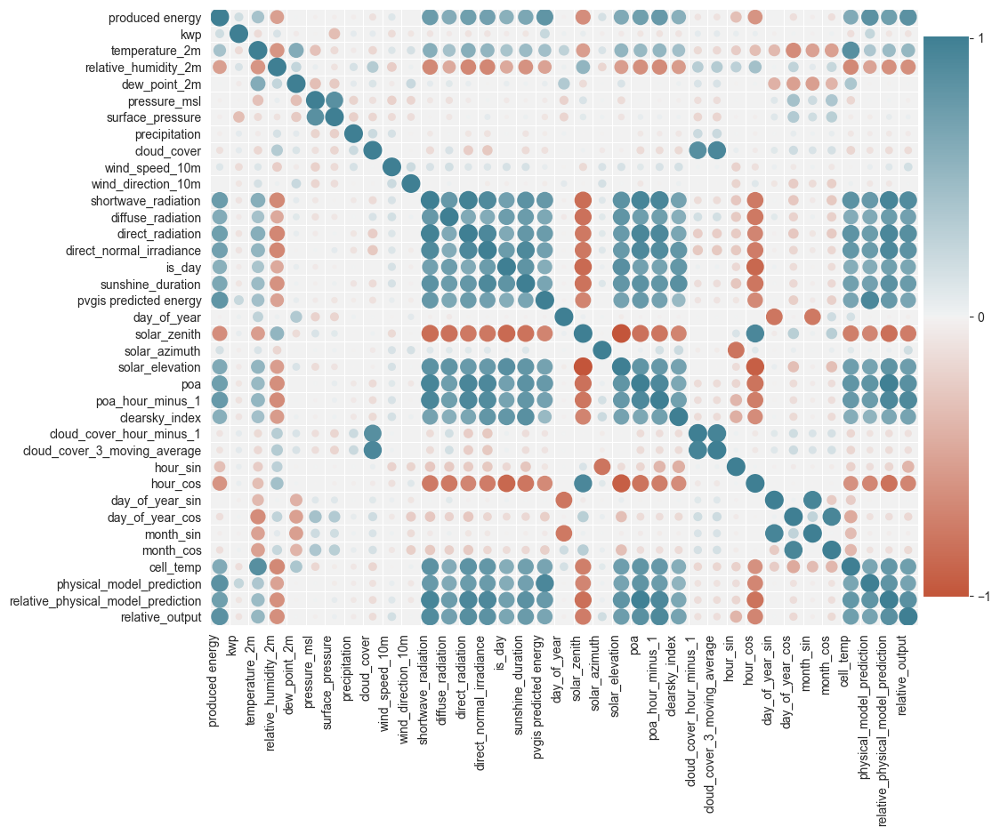

In [342]:
portugal_df_cleaned["datetime"] = pd.to_datetime(portugal_df_cleaned["datetime"])

corr = portugal_df_cleaned.drop(columns=['datetime', 'serial', 'year', 'month', 'day', 'hour', 'minute', "region"]).corr()
corrplot(corr, marker="o", size_scale=200)

## UK

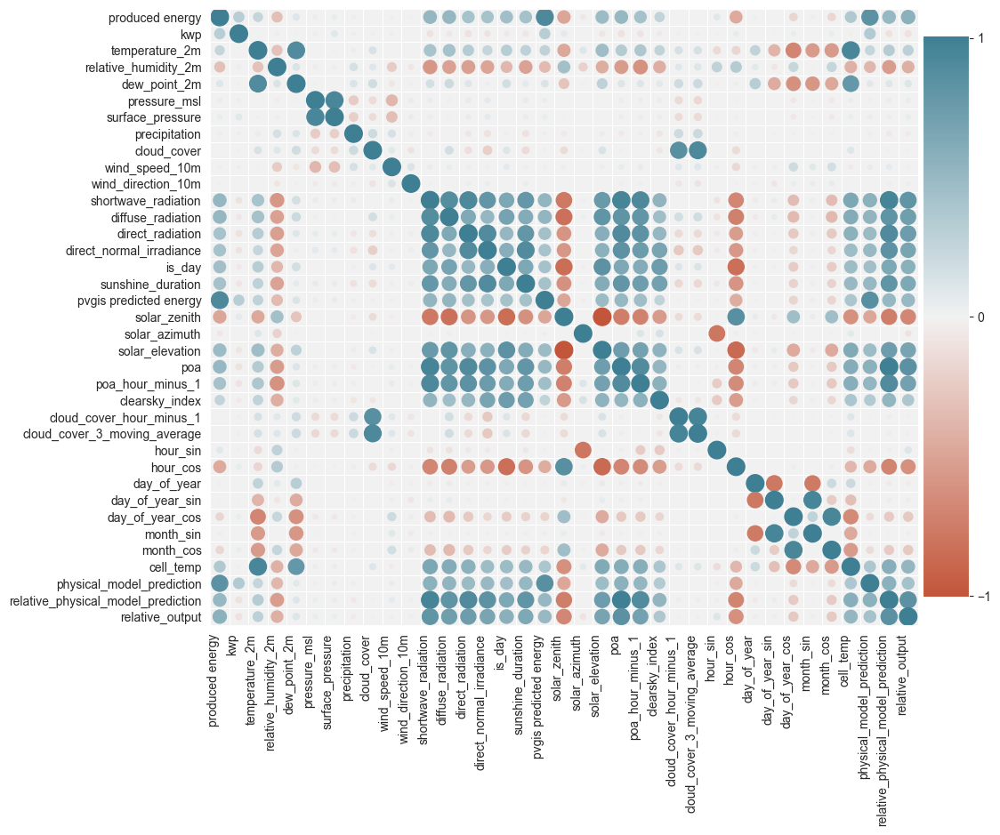

In [345]:
uk_df_cleaned["datetime"] = pd.to_datetime(uk_df_cleaned["datetime"])

corr = uk_df_cleaned.drop(columns=['datetime', 'serial', 'year', 'month', 'day', 'hour', 'minute', "region"]).corr()
corrplot(corr, marker="o", size_scale=200)

# Save df

In [346]:
def save_metadata(metadata_filename, preprocessing_steps, filename=None, description=None, scaler=None):
    """
    Save metadata to a JSON file in the specified format.

    Parameters:
    - metadata_filename (str): The filename for the JSON metadata file.
    - preprocessing_steps (list): List of preprocessing steps applied.
    - filename (str): Name of the corresponding CSV file (optional).
    - description (str): Description of the dataset or preprocessing (optional).
    - scaled (bool): Indicates if the dataset has been scaled (True/False).

    Returns:
    None
    """
    metadata = {
        "filename": filename if filename else "unknown.csv",
        "preprocessing_steps": preprocessing_steps,
        "date": datetime.now().strftime("%Y-%m-%d"),
        "description": description if description else "No description provided.",
        "scaler": scaler  # Indicate whether the dataset has been scaled
    }

    # Save metadata to JSON
    with open(metadata_filename, 'w') as f:
        json.dump(metadata, f, indent=4)

    print(f"Metadata saved as '{metadata_filename}'")

## Portugal

In [348]:
final_df = portugal_df_cleaned.copy()
filename = 'data/PortugalPhotovoltaicDataset/cleaned_data_with_physical_model.csv'
metadata_filename = filename.replace(".csv", "_metadata.json")

final_df.to_csv(filename, index=False)
save_metadata(metadata_filename, preprocessing_steps=["reworked_logical_filtering", "data cleaned separately", "daily data analyzed"], filename=filename, scaler=None, description="Logical filtering. Night data is present. Add Physical Model predictions.")

## UK

In [349]:
final_df = uk_df_cleaned.copy()
filename = 'data/UKOpenClimateFix/cleaned_data_with_physical_model.csv'
metadata_filename = filename.replace(".csv", "_metadata.json")

final_df.to_csv(filename, index=False)
save_metadata(metadata_filename, preprocessing_steps=["reworked_logical_filtering", "data cleaned separately", "daily data analyzed"], filename=filename, scaler=None, description="Logical filtering. Night data is present.  Add Physical Model predictions.")

# Combine Data

In [359]:
combined_df = pd.concat([portugal_df_cleaned, uk_df_cleaned], ignore_index=True)

In [360]:
# Scaling
log_features = [
    "kwp",
    "shortwave_radiation",
    "diffuse_radiation",
    "direct_radiation",
    "direct_normal_irradiance",
    "poa",
    "poa_hour_minus_1",
    "physical_model_prediction",
    "precipitation",
]

unchanged_features = [
    "hour_sin", "hour_cos",
    "day_of_year_sin", "day_of_year_cos",
    "month_sin", "month_cos",
    "is_day",
    "clearsky_index",
    "relative_output",
    "relative_physical_model_prediction",
]

scale_features = [
    "temperature_2m",
    "relative_humidity_2m",
    "dew_point_2m",
    "pressure_msl",
    "surface_pressure",
    "cloud_cover",
    "cloud_cover_3_moving_average",
    "wind_speed_10m",
    "wind_direction_10m",
    "solar_zenith",
    "solar_azimuth",
    "solar_elevation",
    "cloud_cover_hour_minus_1",
    "cell_temp",
    "day_of_year"
]

# Preprocess before splitting
combined_df = combined_df.drop(columns=["region", "pvgis predicted energy", "sunshine_duration", "datetime", "serial", "year", "month", "day", "minute", "hour"])
processed_df, scaler = preprocess_features(combined_df, log_features, unchanged_features, scale_features)

In [361]:
final_df = processed_df.copy()
filename = 'data/CombinedData/cleaned_data_with_physical_model.csv'
metadata_filename = filename.replace(".csv", "_metadata.json")

final_df.to_csv(filename, index=False)
save_metadata(metadata_filename, preprocessing_steps=["reworked_logical_filtering", "data cleaned separately", "daily data analyzed", "Log and Standard scaling applied"], filename=filename, scaler=None, description="Logical filtering. Night data is present.  Add Physical Model predictions.")

Metadata saved as 'data/CombinedData/cleaned_data_with_physical_model_metadata.json'
